## Prototype - Groningen, NL
### Structure
1. Analysis
2. Rules
3. Generation

In [2]:
# load packages
import pandas as pd
import geopandas as gpd
import numpy as np
from pathlib import Path
import os

import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
from matplotlib import colormaps
import seaborn as sns
import plotly.express as px
import shapely
from shapely.geometry import mapping, Polygon, MultiPolygon
import folium
from folium import LayerControl
import contextily as ctx
import fiona
import branca.colormap as cm

%matplotlib inline


ModuleNotFoundError: No module named 'plotly'

### 1️⃣ Analysis 

This step explores Dutch urban patterns across different datasets that are available - CityPy, CBS (Central Statistics Bureau), BAG (Basisregistratie Addressen en Gebouwen) - each offering different spatial and demographic granularity. The aim is to extract attributes (e.g. unit size, housing typology, density) to inform the parameterization of the spatial generator. 

Each subsection targets a specific scale:
- **CityPy**: morphological pattern from city center
- **CBS**: aggregated household distribution 
- **BAG**: building-level housing units detail

These different datasets are combined in the final section to define multiscale rules. 

#### 1.1 CityPy
- **Goal**: Examine **morphological** patterns of housing distribution. For example, *"apartments tend to cluster within n distance from city center"*.
- Relevant layers: city_center, landuse, buildings, grid (building class/typology, 100m x 100m) 

#### 1.2 CBS (500m x 500m grid data)
- **Goal**: Quantify how **household distribution** vary within the given area. Rule based on this data would be, for example, *"cells with average household size > 2.5 tend to have higher % of ..."*
- Relevant data: number_of_residents, average_household_size, single_person_household, single_parent_household, two_parent_household, households_without_children

#### 1.3 BAG
- **Goal**: Examine **per-building** patterns. For example, *"terraced houses have 3 housing units per building with an average surface area of 80m2"*.
- Relevant data: pand (buildings) layer with number of housing units per building, with surface area

#### 1.4 CityPy + CBS + BAG 
- **Goal**: Cross-reference **urban morphology, household distribution, and building-level housing capacity** to define spatial rules. For example, *"areas with apartment-dominant blocks near city center show high % of single-person households and smaller unit sizes"*.

----------------

#### 1.1 Examine CityPy Output - Groningen as an example
- load data
- select useful layers: "extents", "**landuse**", "**city_center**", "water", "terrain", "road_nodes", "tesselation", "enclosures", "**road_edges**", "**buildings**", "**grid**"
- spatial + visual output

In [ ]:
### load CityPy outputs - Groningen as an example
groningen_citypy_path = "../data/citypy/Groningen_NL.gpkg"
groningen_citypy = gpd.read_file(groningen_citypy_path)

# check crs
print(f"CRS of groningen_citypy: {groningen_citypy.crs}\n")

# list all layers in gpkg
layers = fiona.listlayers(groningen_citypy_path)
print("Available layers in Groningen CityPy gpkg:")
for layer in layers:
    print("-", layer)


CRS of groningen_citypy: EPSG:32632

Available layers in Groningen CityPy gpkg:
- extents
- landuse
- city_center
- water
- terrain
- road_nodes
- tesselation
- enclosures
- road_edges
- buildings
- grid


/Users/hyejijoh/Library/Caches/pypoetry/virtualenvs/thesis-Cyw0LxUp-py3.13/lib/python3.13/site-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'Groningen_NL.gpkg': 'extents' (default), 'landuse', 'city_center', 'water', 'terrain', 'road_nodes', 'tesselation', 'enclosures', 'road_edges', 'buildings', 'grid'. Specify layer parameter to avoid this warning.
  result = read_func(


In [ ]:
# get extents of Groningen and save them to a bbox geodataframe
minx, miny, maxx, maxy = groningen_extents = gpd.read_file(groningen_citypy_path, layer="extents").total_bounds

print(f"Extents of Groningen: {minx}, {miny}, {maxx}, {maxy}")

groningen_bbox = gpd.GeoDataFrame(geometry=[shapely.box(minx, miny, maxx, maxy)], crs=groningen_citypy.crs)


Extents of Groningen: 330535.221304854, 5894961.615380439, 344166.9271243607, 5904544.200493102


In [ ]:
# call all each layer as a layer with the same name in the same gpkg
# e.g. city_center = gpd.read_file(groningen_citypy_path, layer="city_center")
for layer in layers:
    globals()[layer] = gpd.read_file(groningen_citypy_path, layer=layer)

# convert all layers' crs to WGS84 folium and add the name "_folium"
for layer in layers:
    globals()[f"{layer}_folium"] = globals()[layer].to_crs(epsg=4326)

groningen_bbox_folium = groningen_bbox.to_crs(epsg=4326)


In [ ]:
# print all layers
print(layers)

['extents', 'landuse', 'city_center', 'water', 'terrain', 'road_nodes', 'tesselation', 'enclosures', 'road_edges', 'buildings', 'grid']


In [ ]:
city_center.head()

,name,geometry
0,Groningen,POINT (337629.16 5899400.912)


In [ ]:
groningen_bbox.crs

<Projected CRS: EPSG:32632>
Name: WGS 84 / UTM zone 32N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 6°E and 12°E, northern hemisphere between equator and 84°N, onshore and offshore. Algeria. Austria. Cameroon. Denmark. Equatorial Guinea. France. Gabon. Germany. Italy. Libya. Liechtenstein. Monaco. Netherlands. Niger. Nigeria. Norway. Sao Tome and Principe. Svalbard. Sweden. Switzerland. Tunisia. Vatican City State.
- bounds: (6.0, 0.0, 12.0, 84.0)
Coordinate Operation:
- name: UTM zone 32N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
groningen_bbox_folium.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
# plot selected layers on top of each other - use folium
# extents, city_center, landuse, buildings, grid, bbox, (tesselation, enclosures, road_edges)

# center on groningen city center 
m = folium.Map(location=[city_center_folium.geometry.y, city_center_folium.geometry.x], zoom_start=12, tiles = "CartoDB Positron", width = "800px", height = "600px")

# ---- add city center as a red circle marker
folium.CircleMarker(location=[city_center_folium.geometry.y, city_center_folium.geometry.x], name = "city center", radius=3, color="red", fill=True, fill_color="red", fill_opacity=1).add_to(m)

# ---- add bbox
folium.GeoJson(groningen_bbox_folium, name = "bbox", style_function = lambda x: {"fillColor": "transparent", "color": "black", "weight": 1, "opacity": 0.8}).add_to(m)

# ---- add extents
folium.GeoJson(extents_folium, name = "extents", style_function = lambda x: {"fillColor": "transparent", "color": "blue", "weight": 2, "opacity": 0.8}).add_to(m)

# ---- add landuse
## plot by "landuse_class" attribute
landuse_types = landuse_folium["landuse_class"].dropna().unique()
#print(landuse_types)

## color map
viridis_landuse = colormaps['viridis']
landuse_colors = {
    cls: to_hex(viridis_landuse(i / (len(landuse_types) - 1))) 
    for i, cls in enumerate(landuse_types)
}

## clip to extents as well as droping null values
landuse_clipped = landuse_folium[
    landuse_folium["landuse_class"].notna()
].clip(extents_folium)

folium.GeoJson(
    landuse_clipped, 
    name = "landuse", 
    style_function = lambda x: {
        "fillColor": landuse_colors.get(x["properties"]["landuse_class"], "#cccccc"), 
        "color": "black", 
        "weight": 1, 
        "fillOpacity": 0.8}).add_to(m)

# ---- add tesselation
#folium.GeoJson(tesselation_folium, name = "tesselation", style_function = lambda x: {"fillColor": "transparent", "color": "orange", "weight":2, "opacity": 0.8}).add_to(m)

# # ---- add buildings
# ## use Groningen_NL_bldgs_filtered.gpkg
# buildings_filtered = gpd.read_file('../data/citypy/Groningen_NL_bldgs_filtered.gpkg')
# buildings_filtered_bbox = buildings_filtered.to_crs(epsg=4326)

# ## color by unique values of 'building_class' in buildings_filtered_bbox
# building_classes = buildings_filtered_bbox["building_class"].unique()

# # color map - plasma
# plasma_building_class = colormaps['plasma']
# building_class_colors = {
#     cls: to_hex(plasma_building_class(i / (len(building_classes) - 1))) 
#     for i, cls in enumerate(building_classes)
# }
# folium.GeoJson(
#     buildings_filtered_bbox, 
#     name = "buildings", 
#     style_function = lambda x: {
#         "fillColor": building_class_colors.get(x["properties"]["building_class"], "#cccccc"), 
#         "color": "black", 
#         "weight": 1, 
#         "fillOpacity": 0.8}).add_to(m)

# ---- add grid
## use Groningen_NL_grid_filtered.gpkg
grid_filtered = gpd.read_file('../data/citypy/Groningen_NL_grid_filtered.gpkg')
grid_filtered_bbox = grid_filtered.to_crs(epsg=4326)

## color by unique values of 'building_class' in grid_filtered_bbox
building_classes = grid_filtered_bbox["building_class"].unique()

# color map - plasma
plasma_building_class = colormaps['plasma']
building_class_colors = {
    cls: to_hex(plasma_building_class(i / (len(building_classes) - 1))) 
    for i, cls in enumerate(building_classes)
}
folium.GeoJson(
    grid_filtered_bbox, 
    name = "grid", 
    style_function = lambda x: {
        "fillColor": building_class_colors.get(x["properties"]["building_class"], "#cccccc"), 
        "color": "black", 
        "weight": 1, 
        "fillOpacity": 0.8}).add_to(m)

# add layer control
folium.LayerControl().add_to(m)
m

/Users/hyejijoh/Library/Caches/pypoetry/virtualenvs/thesis-Cyw0LxUp-py3.13/lib/python3.13/site-packages/folium/utilities.py:101: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  float(coord)
/Users/hyejijoh/Library/Caches/pypoetry/virtualenvs/thesis-Cyw0LxUp-py3.13/lib/python3.13/site-packages/folium/utilities.py:107: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  if math.isnan(float(coord)):
/Users/hyejijoh/Library/Caches/pypoetry/virtualenvs/thesis-Cyw0LxUp-py3.13/lib/python3.13/site-packages/folium/utilities.py:109: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  return [float(x) for x in coords]


In [ ]:
# create a city center buffer 
buffer = [1000, 2000, 3000, 5000, 7000]
city_center_buffer = gpd.GeoDataFrame(
    {"distance_m": buffer},
    geometry = [city_center.geometry.iloc[0].buffer(dist) for dist in buffer],
    crs=city_center.crs
)

#city_center_buffer.head()

# save as a geodataframe
#city_center_buffer_df = city_center_buffer.reset_index()
city_center_buffer.columns = ["distance_m", "geometry"]
city_center_buffer.to_file("../data/citypy/layers_cleaned/city_center_buffer.gpkg", driver="GPKG")
#city_center_buffer.head()
#city_center_buffer.crs # epsg:32632

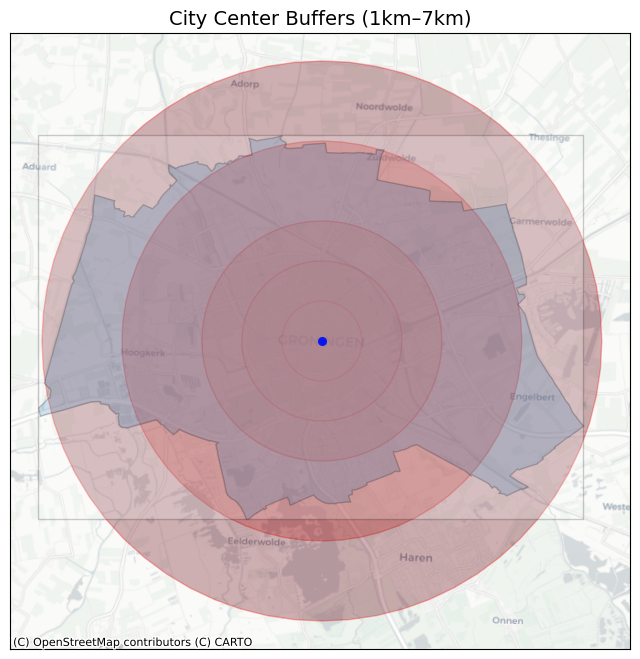

In [ ]:
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xticks([])
ax.set_yticks([])

# Plot buffers with transparency and color map
city_center_buffer.plot(ax=ax, column="distance_m", cmap="Reds", alpha=0.3, edgecolor="red")

groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)
# Plot city center point
city_center.plot(ax=ax, color="blue", markersize=30)
extents.plot(ax=ax, edgecolor="black", alpha = 0.2)

plt.title("City Center Buffers (1km–7km)", fontsize=14)
plt.axis("equal")
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.show()

<class 'shapely.geometry.polygon.Polygon'>
POLYGON ((339619.5294159852 5899204.878068769, 339590.73052344733 5899010.7317053955, 339543.0406341053 5898820.342994919, 339476.9190276634 5898635.545484697, 339393.00249133754 5898458.118875776, 339292.09918724594 5898289.771883389, 339175.18086936633 5898132.125781101, 339043.3735250139 5897986.698787055, 338897.9465309681 5897854.891442702, 338740.30042868 5897737.973124823, 338571.9534362928 5897637.069820731, 338394.52682737104 5897553.153284405, 338209.7293171498 5897487.031677963, 338019.3406066731 5897439.341788622, 337825.19424329995 5897410.542896084, 337629.15996264084 5897400.912349428, 337433.12568198174 5897410.542896084, 337238.9793186086 5897439.341788622, 337048.5906081319 5897487.031677963, 336863.79309791065 5897553.153284405, 336686.36648898886 5897637.069820731, 336518.01949660166 5897737.973124823, 336360.37339431356 5897854.891442702, 336214.94640026777 5897986.698787055, 336083.13905591535 5898132.125781101, 335966.22

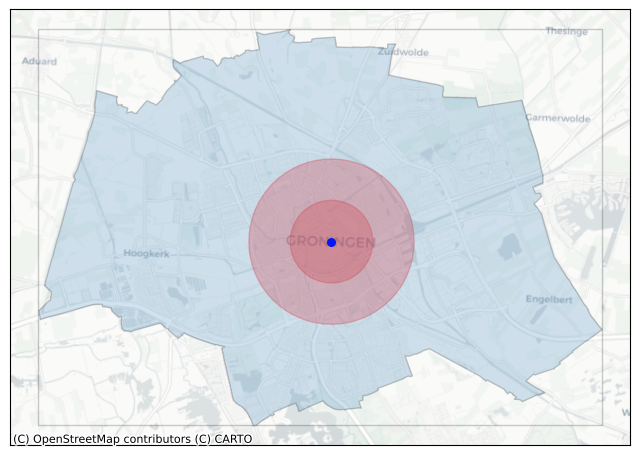

In [ ]:
# city center buffer
city_center_buffer.head()

# get new polygon until 2km buffer - focus on this region for now 
city_center_buffer_2km = city_center_buffer[city_center_buffer["distance_m"] <= 2000]
city_center_buffer_2km.head()

# get new polygon until 1km buffer as well
city_center_buffer_1km = city_center_buffer[city_center_buffer["distance_m"] <= 1000]
city_center_buffer_1km.head()

# get the two polygons from your buffer GeoDataFrame
buffer_1km = city_center_buffer.loc[city_center_buffer["distance_m"] == 1000, "geometry"].values[0]
buffer_2km = city_center_buffer.loc[city_center_buffer["distance_m"] == 2000, "geometry"].values[0]

# create ring polygon (2km minus 1km)
ring_1km_2km = buffer_2km.difference(buffer_1km)

# this is now just a shapely Polygon (or MultiPolygon)
print(type(ring_1km_2km))
print(ring_1km_2km)

# plot 2km buffer
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xticks([])   
ax.set_yticks([])
city_center_buffer_2km.plot(ax=ax, color="red", alpha=0.3, edgecolor="red")
groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)
city_center.plot(ax=ax, color="blue", markersize=30)
extents.plot(ax=ax, edgecolor="black", alpha = 0.2)
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.show()

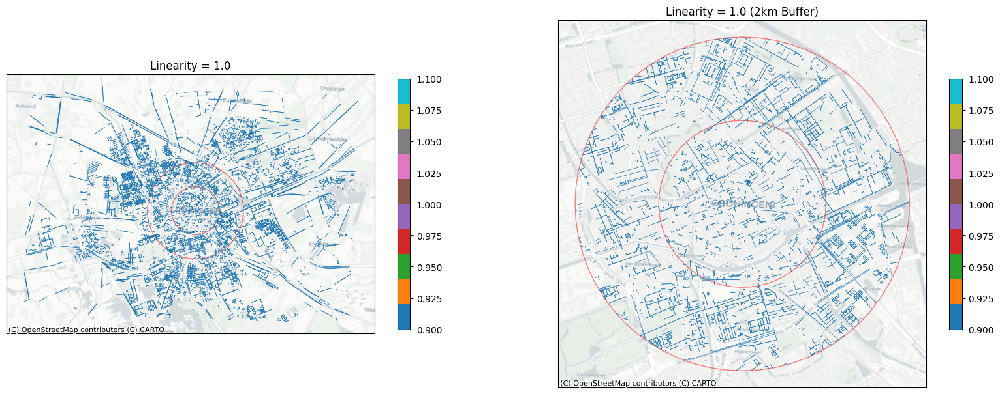

In [ ]:
# plot road_edges by 'linearity' between 0.8 and 0.5   
# plot the same thing side by side but with the 2km buffer clipped    
                             
road_edges_linearity = road_edges[road_edges["stretch_linearity"] == 1.0]   
road_edges_linearity_2km = road_edges_linearity.clip(city_center_buffer_2km)

# plot the same thing side by side but with the 2km buffer clipped    
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
axes = axes.flatten()

axes[0].set_xticks([])
axes[0].set_yticks([])
axes[0].set_title("Linearity = 1.0")
axes[1].set_title("Linearity = 1.0 (2km Buffer)")
axes[1].set_xticks([])
axes[1].set_yticks([])
road_edges_linearity.plot(ax=axes[0], column = "stretch_linearity", cmap = "tab10", legend = True, legend_kwds = {"shrink": 0.5}, linewidth = 0.5)
road_edges_linearity_2km.plot(ax=axes[1], column = "stretch_linearity", cmap = "tab10", legend = True, legend_kwds = {"shrink": 0.5}, linewidth = 0.5)
city_center_buffer_2km.plot(ax=axes[0], facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)
city_center_buffer_2km.plot(ax=axes[1], facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)
ctx.add_basemap(axes[0], crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(axes[1], crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.show()

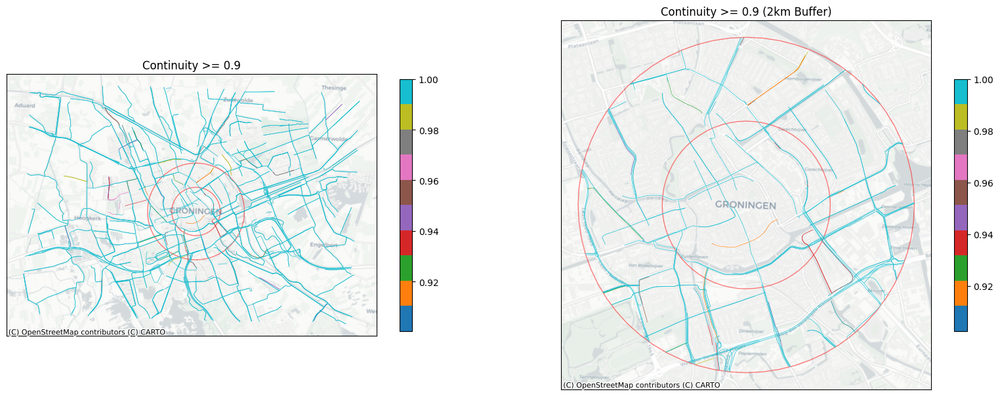

In [ ]:
# plot road_edges by 'continuity' >= 1
road_edges_continuity = road_edges[road_edges["continuity"] >= 0.9]
road_edges_continuity_2km = road_edges_continuity.clip(city_center_buffer_2km)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
axes = axes.flatten()

axes[0].set_xticks([])
axes[0].set_yticks([])
axes[0].set_title("Continuity >= 0.9")
axes[1].set_title("Continuity >= 0.9 (2km Buffer)")
axes[1].set_xticks([])
axes[1].set_yticks([])
road_edges_continuity.plot(ax=axes[0], column = "continuity", cmap = "tab10", legend = True, legend_kwds = {"shrink": 0.5}, linewidth = 0.5)
road_edges_continuity_2km.plot(ax=axes[1], column = "continuity", cmap = "tab10", legend = True, legend_kwds = {"shrink": 0.5}, linewidth = 0.5)
city_center_buffer_2km.plot(ax=axes[0], facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)
city_center_buffer_2km.plot(ax=axes[1], facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)
ctx.add_basemap(axes[0], crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(axes[1], crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.show()
#road_edges.columns

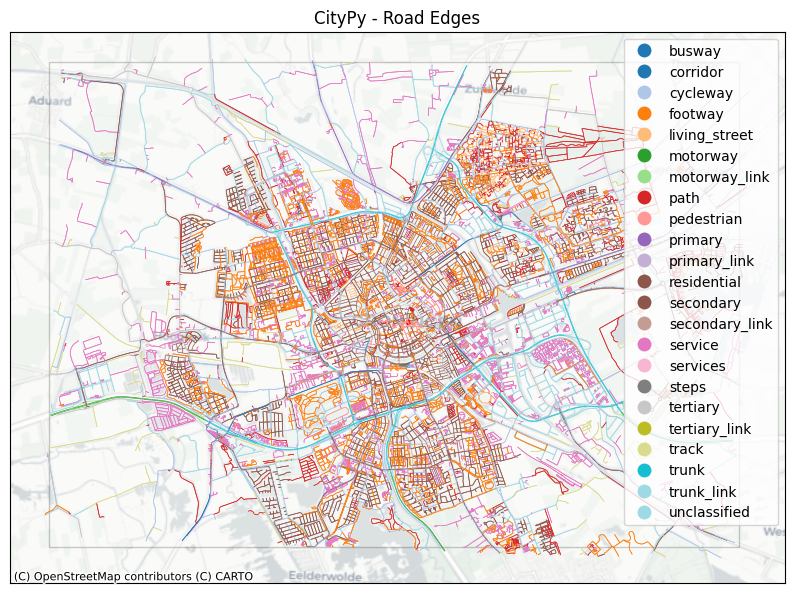

In [ ]:
# plot road edges
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# bbox
groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)

# plot road edges by 'test_clusters', thin lines    
road_edges.plot(ax=ax, column = "highway", cmap = "tab20", legend = True, linewidth = 0.5)

# plot city center
city_center.plot(ax=ax, color = "red", markersize = 10)

ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Road Edges")
plt.show()

In [ ]:
# statistics for road_edges per 'highway' type in %, by 2 decimal places    
road_edges_pct = road_edges.groupby("highway").size() / len(road_edges) * 100
road_edges_pct = road_edges_pct.round(2)
print(f"Road edges percentage: {road_edges_pct} %")

# save as a dataframe and as a csv for later use
road_edges_pct_df = road_edges_pct.reset_index()
road_edges_pct_df.columns = ["road_type", "percentage"]
road_edges_pct_df.to_csv("../data/citypy/layers_cleaned/road_edges_pct.csv", index=False)

road_edges_pct_df.head()


Road edges percentage: highway
busway             0.74
corridor           0.03
cycleway          14.09
footway           25.08
living_street      1.82
motorway           0.11
motorway_link      0.10
path               8.62
pedestrian         0.73
primary            0.62
primary_link       0.05
residential       14.28
secondary          3.24
secondary_link     0.08
service           15.42
services           0.05
steps              0.31
tertiary           5.23
tertiary_link      0.01
track              1.78
trunk              0.83
trunk_link         1.16
unclassified       5.62
dtype: float64 %


,road_type,percentage
0,busway,0.74
1,corridor,0.03
2,cycleway,14.09
3,footway,25.08
4,living_street,1.82


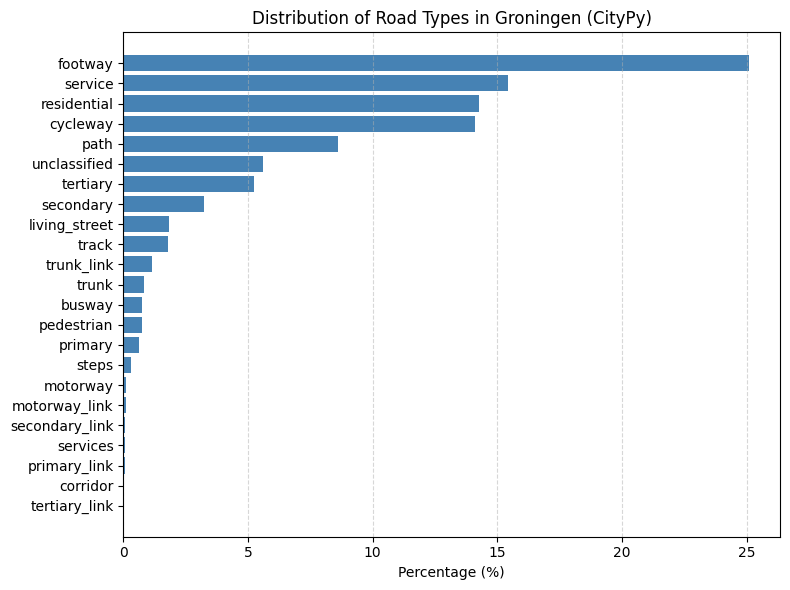

In [ ]:
# plot this as a bar chart
road_edges_pct_df_sorted = road_edges_pct_df.sort_values("percentage", ascending=True)

plt.figure(figsize=(8, 6))
plt.barh(road_edges_pct_df_sorted["road_type"], road_edges_pct_df_sorted["percentage"], color="steelblue")
plt.xlabel("Percentage (%)")
plt.title("Distribution of Road Types in Groningen (CityPy)")
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


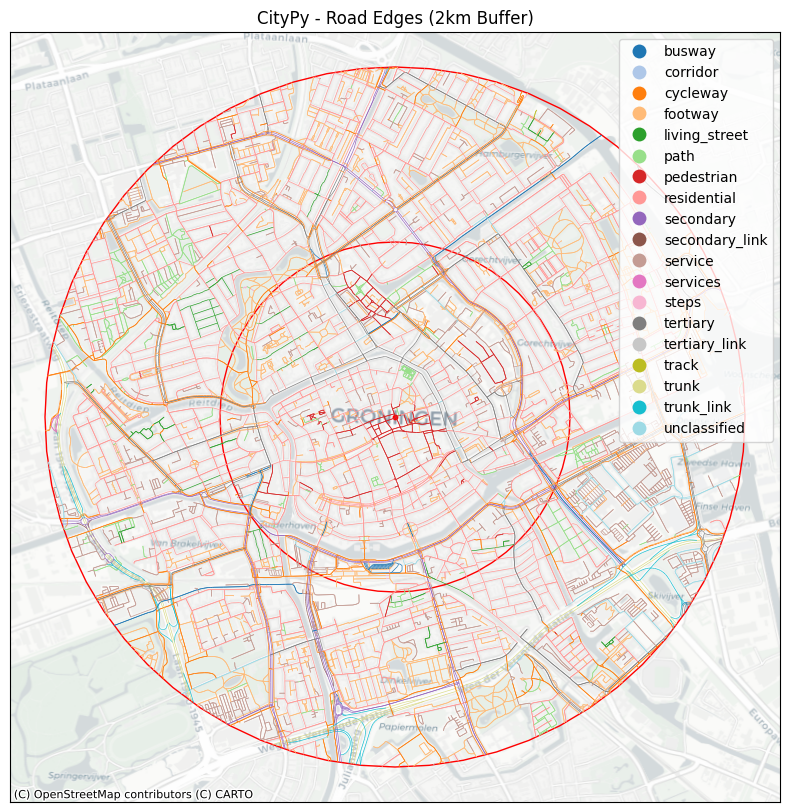

In [ ]:
# clip road_edges to 2km buffer
road_edges_2km = road_edges.clip(city_center_buffer_2km)
road_edges_2km.head()

# plot road_edges_2km
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])           
ax.set_yticks([])

# city center
city_center.plot(ax=ax, color = "red", markersize = 10)

# buffer 2km - transparent, only edge visible   
city_center_buffer_2km.plot(ax=ax, facecolor = "none", edgecolor = "red", linewidth = 1)                     

# road_edges_2km
road_edges_2km.plot(ax=ax, column = "highway", cmap = "tab20", legend = True, linewidth = 0.5, alpha = 1)

ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)

plt.title("CityPy - Road Edges (2km Buffer)")
plt.show()

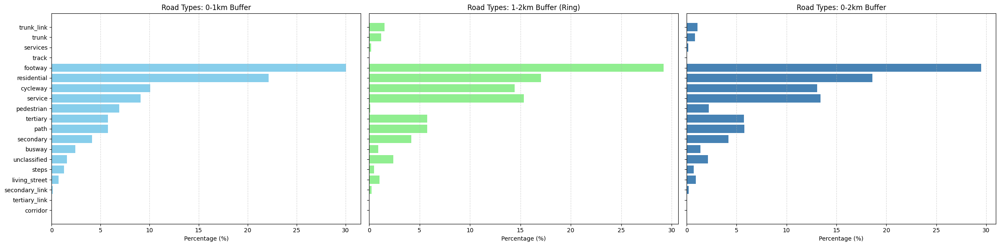

In [ ]:
# Calculate metrics by buffer distance areas: 0-1km, 1-2km (the ring), and 0-2km

# 1. Use the already created buffers:
#    - city_center_buffer_1km (0-1km)
#    - city_center_buffer_2km (0-2km)
#    - ring_1km_2km (1-2km ring)

# 2. Clip road_edges to each buffer
road_edges_1km = road_edges.clip(city_center_buffer_1km)
road_edges_2km = road_edges.clip(city_center_buffer_2km)
road_edges_ring_1km_2km = road_edges.clip(ring_1km_2km)

# 3. Calculate percentages for each area

def road_type_percentage(road_edges_gdf, col="highway"):
    pct = road_edges_gdf.groupby(col).size() / len(road_edges_gdf) * 100
    pct = pct.round(2)
    df = pct.reset_index()
    df.columns = ["road_type", "percentage"]
    return df.sort_values("percentage", ascending=True)

road_edges_pct_1km_df = road_type_percentage(road_edges_1km)
road_edges_pct_ring_1km_2km_df = road_type_percentage(road_edges_ring_1km_2km)
road_edges_pct_2km_df = road_type_percentage(road_edges_2km)

# 4. Plotting

fig, axes = plt.subplots(1, 3, figsize=(24, 6), sharey=True)

# 0-1km
axes[0].barh(road_edges_pct_1km_df["road_type"], road_edges_pct_1km_df["percentage"], color="skyblue")
axes[0].set_xlabel("Percentage (%)")
axes[0].set_title("Road Types: 0-1km Buffer")
axes[0].grid(axis='x', linestyle='--', alpha=0.5)

# 1-2km (the ring)
axes[1].barh(road_edges_pct_ring_1km_2km_df["road_type"], road_edges_pct_ring_1km_2km_df["percentage"], color="lightgreen")
axes[1].set_xlabel("Percentage (%)")
axes[1].set_title("Road Types: 1-2km Buffer (Ring)")
axes[1].grid(axis='x', linestyle='--', alpha=0.5)

# 0-2km
axes[2].barh(road_edges_pct_2km_df["road_type"], road_edges_pct_2km_df["percentage"], color="steelblue")
axes[2].set_xlabel("Percentage (%)")
axes[2].set_title("Road Types: 0-2km Buffer")
axes[2].grid(axis='x', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

In [ ]:
# plot using plotly
fig = px.bar(road_edges_pct_df_sorted, x="percentage", y="road_type", color="road_type", title="Distribution of Road Types in Groningen (CityPy)")
fig.show()



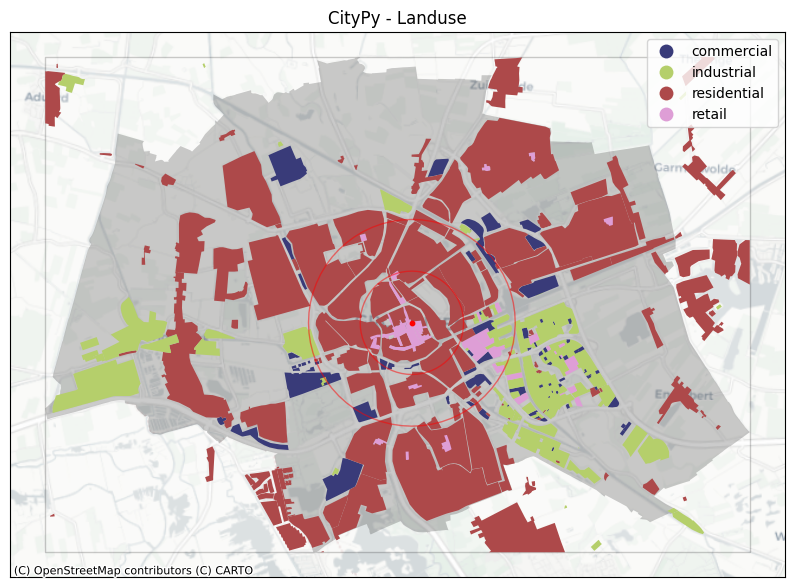

In [ ]:
# plot landuse
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# bbox
groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)

# extents
extents.plot(ax=ax, color = "black", alpha = 0.2)

# landuse - by 'landuse_class', and clip by the bbox, add legend
landuse = landuse.clip(groningen_bbox)
landuse.plot(ax=ax, column = "landuse_class", cmap = "tab20b", legend = True)

# city center, always be the topmost layer  
city_center.plot(ax=ax, color = "red", markersize = 10)

city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)

# base map
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Landuse")
plt.show()



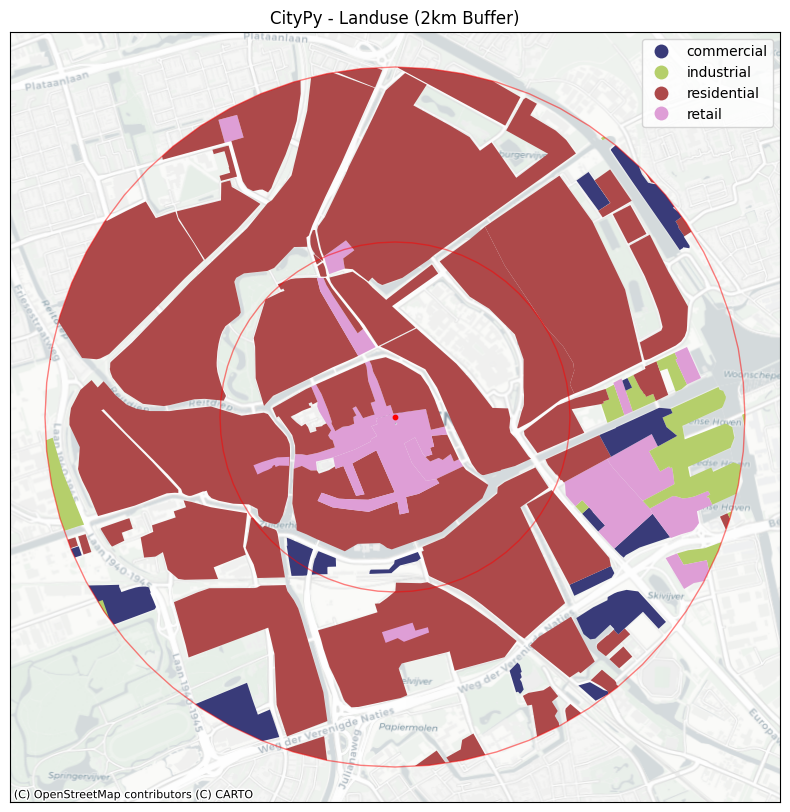

In [ ]:
# plot landuse clipped by 2km
landuse_2km = landuse.clip(city_center_buffer_2km)

fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# bbox
#groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)

# extents
#extents.plot(ax=ax, color = "black", alpha = 0.2)

# landuse - by 'landuse_class', and clip by the bbox, add legend
landuse_2km.plot(ax=ax, column = "landuse_class", cmap = "tab20b", legend = True)

# city center, always be the topmost layer  
city_center.plot(ax=ax, color = "red", markersize = 10)

city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)

# base map
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Landuse (2km Buffer)")
plt.show()

In [ ]:
# create functions to calculate the area percentage of each landuse class within the 1km, 1-2km, 2km buffer
# and to plot charts
def calculate_area_percentages(gdf, buffer_geom, class_column):
    """
    Clip a GeoDataFrame to buffer geometry, calculate area per class, return percentages DataFrame.
    """
    clipped = gdf.clip(buffer_geom)
    clipped["area"] = clipped.geometry.area
    area_by_class = clipped.groupby(class_column)["area"].sum()
    total_area = area_by_class.sum()
    pct = (area_by_class / total_area * 100).round(2)
    df = pct.reset_index()
    df.columns = [class_column, "percentage"]
    return df

def calculate_area_percentages_ring(gdf, outer_buffer, inner_buffer, class_column):
    """
    Calculate area percentages within a ring (outer minus inner).
    """
    ring_geom = outer_buffer.difference(inner_buffer.unary_union)
    return calculate_area_percentages(gdf, ring_geom, class_column)

def plot_side_by_side(dfs, titles, class_column):
    """
    Plot three separate bar charts side by side.
    """
    fig, axes = plt.subplots(1, 3, figsize=(24, 6), sharey=True)

    colors = ["skyblue", "lightgreen", "salmon"]
    for i, (df, title, color) in enumerate(zip(dfs, titles, colors)):
        bars = axes[i].bar(df[class_column], df["percentage"], color=color)
        axes[i].set_title(title)
        axes[i].set_xlabel(class_column)
        axes[i].set_ylabel("Percentage (%)")
        axes[i].bar_label(bars, labels=[f"{v:.2f}%" for v in df["percentage"]], padding=3)
        axes[i].tick_params(axis='x', rotation=45)
        axes[i].grid(axis='y', linestyle='--', alpha=0.5)

    plt.tight_layout()
    plt.show()

def plot_grouped(dfs, labels, class_column):
    """
    Plot grouped bar chart comparing percentages across buffers.
    """
    # Ensure all classes present
    all_classes = sorted(set.union(*[set(df[class_column]) for df in dfs]))
    def fill_missing(df): 
        return df.set_index(class_column).reindex(all_classes, fill_value=0).reset_index()

    dfs_filled = [fill_missing(df) for df in dfs]

    x = np.arange(len(all_classes))
    width = 0.25

    fig, ax = plt.subplots(figsize=(16, 8))
    colors = ["skyblue", "lightgreen", "salmon"]

    bars = []
    for i, (df, label, color) in enumerate(zip(dfs_filled, labels, colors)):
        b = ax.bar(x + (i - 1) * width, df["percentage"], width, label=label, color=color)
        bars.append(b)

    ax.set_ylim(0, 100)
    ax.set_xlabel(class_column)
    ax.set_ylabel("Percentage (%)")
    ax.set_title(f"{class_column} Percentage by Buffer")
    ax.set_xticks(x)
    ax.set_xticklabels(all_classes, rotation=45, ha="right")
    ax.legend()
    ax.grid(axis='y', linestyle='--', alpha=0.5)

    # Labels
    for b in bars:
        ax.bar_label(b, labels=[f"{v:.2f}%" for v in b.datavalues], padding=3)

    plt.tight_layout()
    plt.show()

/var/folders/h9/289jzm0x6t5gf73w3pky7x2c0000gn/T/ipykernel_87897/3513633466.py:20: DeprecationWarning:

The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.



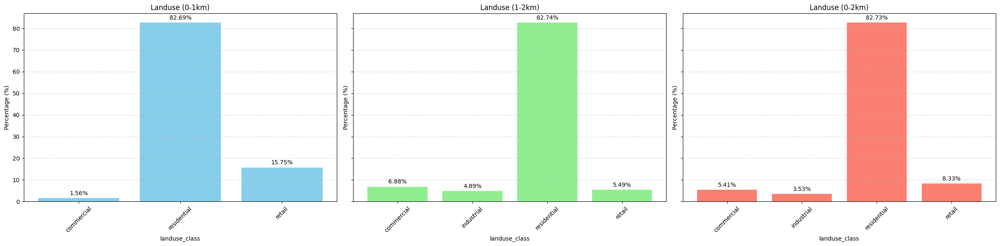

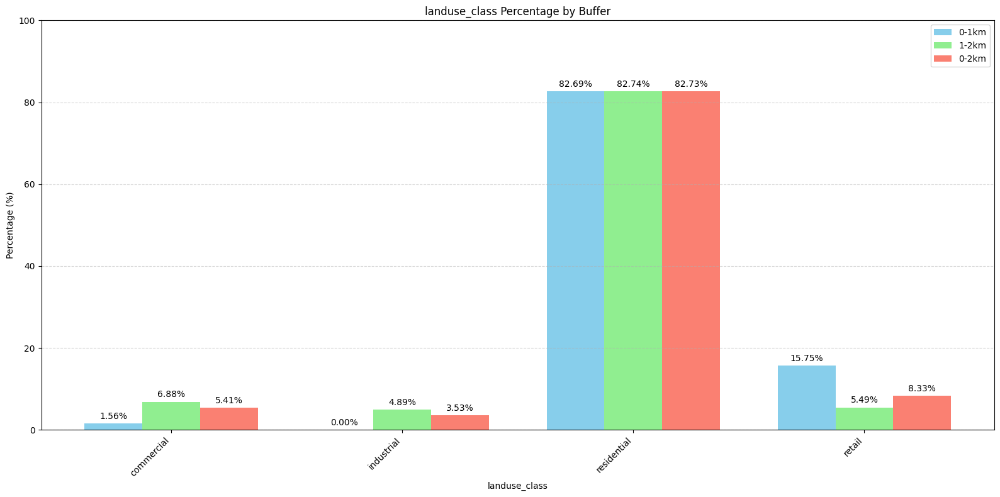

In [ ]:
# use functions for landluse
# Compute percentages
landuse_1km_df   = calculate_area_percentages(landuse, city_center_buffer_1km, "landuse_class")
landuse_2km_df   = calculate_area_percentages(landuse, city_center_buffer_2km, "landuse_class")
landuse_1_2km_df = calculate_area_percentages_ring(landuse, city_center_buffer_2km, city_center_buffer_1km, "landuse_class")

# Plot side-by-side
plot_side_by_side(
    [landuse_1km_df, landuse_1_2km_df, landuse_2km_df],
    ["Landuse (0-1km)", "Landuse (1-2km)", "Landuse (0-2km)"],
    "landuse_class"
)

# Plot grouped
plot_grouped(
    [landuse_1km_df, landuse_1_2km_df, landuse_2km_df],
    ["0-1km", "1-2km", "0-2km"],
    "landuse_class"
)


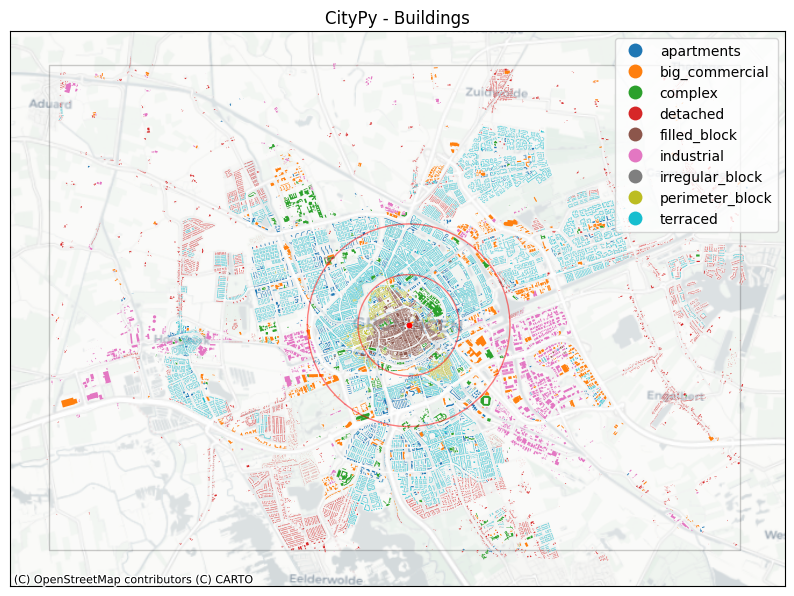

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# bbox
groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)

# extents
#extents.plot(ax=ax, color = "black", alpha = 0.2)

# buildings by building_class
buildings.plot(ax=ax, column = "building_class", cmap = "tab10", legend = True)

# city center, always be the topmost layer  
city_center.plot(ax=ax, color = "red", markersize = 10)
city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)

# base map
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Buildings")
plt.show()

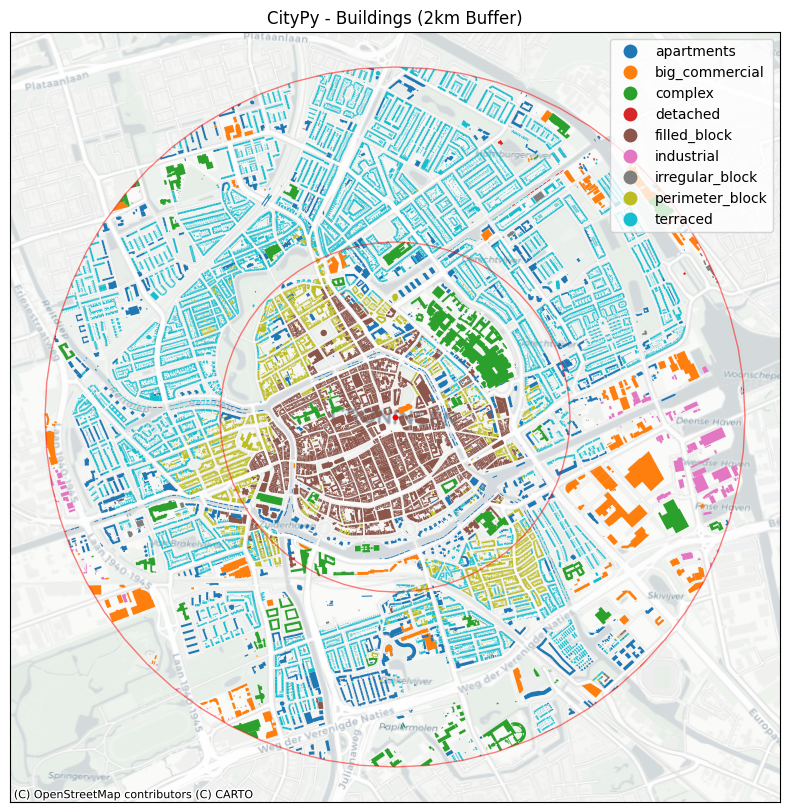

In [ ]:
# plot buidling clipped by 2km
buildings_2km = buildings.clip(city_center_buffer_2km)

fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# bbox
#groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)

# extents
#extents.plot(ax=ax, color = "black", alpha = 0.2)

# buildings by building_class
buildings_2km.plot(ax=ax, column = "building_class", cmap = "tab10", legend = True)

# city center, always be the topmost layer  
city_center.plot(ax=ax, color = "red", markersize = 10)

city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)

# base map
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Buildings (2km Buffer)")
plt.show()

/var/folders/h9/289jzm0x6t5gf73w3pky7x2c0000gn/T/ipykernel_87897/3513633466.py:20: DeprecationWarning:

The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.



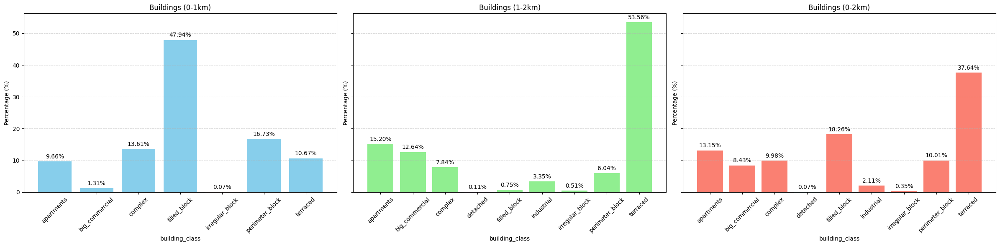

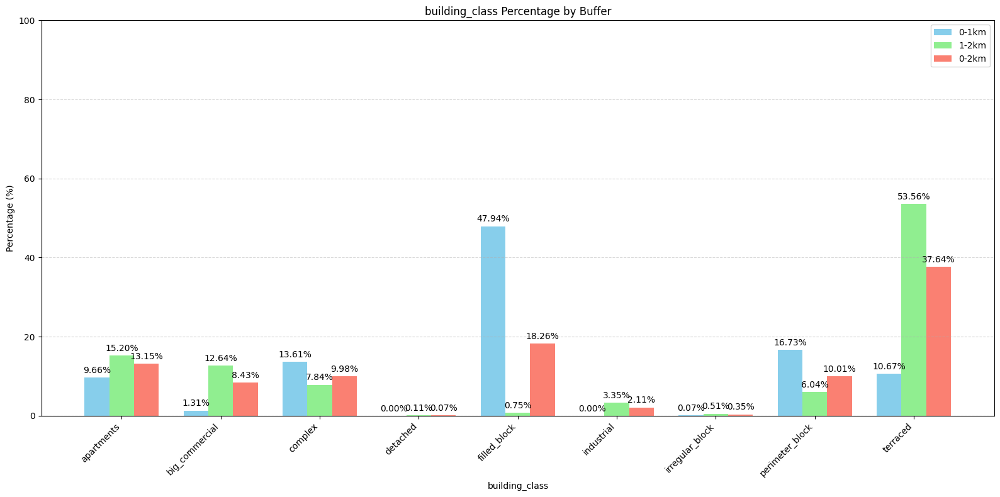

In [ ]:
# use functions for buildings
buildings_1km_df   = calculate_area_percentages(buildings, city_center_buffer_1km, "building_class")
buildings_2km_df   = calculate_area_percentages(buildings, city_center_buffer_2km, "building_class")
buildings_1_2km_df = calculate_area_percentages_ring(buildings, city_center_buffer_2km, city_center_buffer_1km, "building_class")

plot_side_by_side(
    [buildings_1km_df, buildings_1_2km_df, buildings_2km_df],
    ["Buildings (0-1km)", "Buildings (1-2km)", "Buildings (0-2km)"],
    "building_class"
)

plot_grouped(
    [buildings_1km_df, buildings_1_2km_df, buildings_2km_df],
    ["0-1km", "1-2km", "0-2km"],
    "building_class"
)

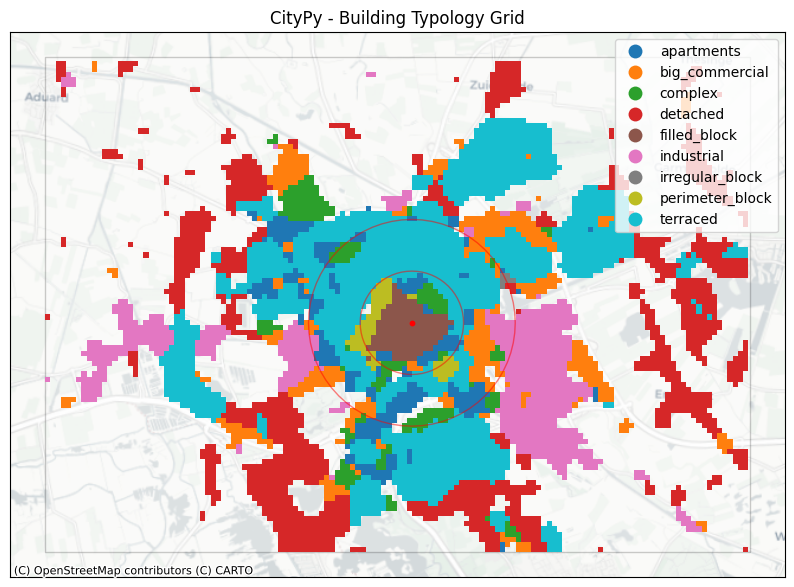

In [ ]:
# plot grid excluding 'others' from the building_class

grid_filtered_without_others = grid_filtered[grid_filtered["building_class"] != "other"]
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# bbox
groningen_bbox.plot(ax=ax, color="white", edgecolor="black", alpha = 0.2)

grid_filtered_without_others.plot(ax=ax, column = "building_class", cmap = "tab10", legend = True)

# city center, always be the topmost layer  
city_center.plot(ax=ax, color = "red", markersize = 10)
city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)
# base map
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Building Typology Grid")
plt.show()

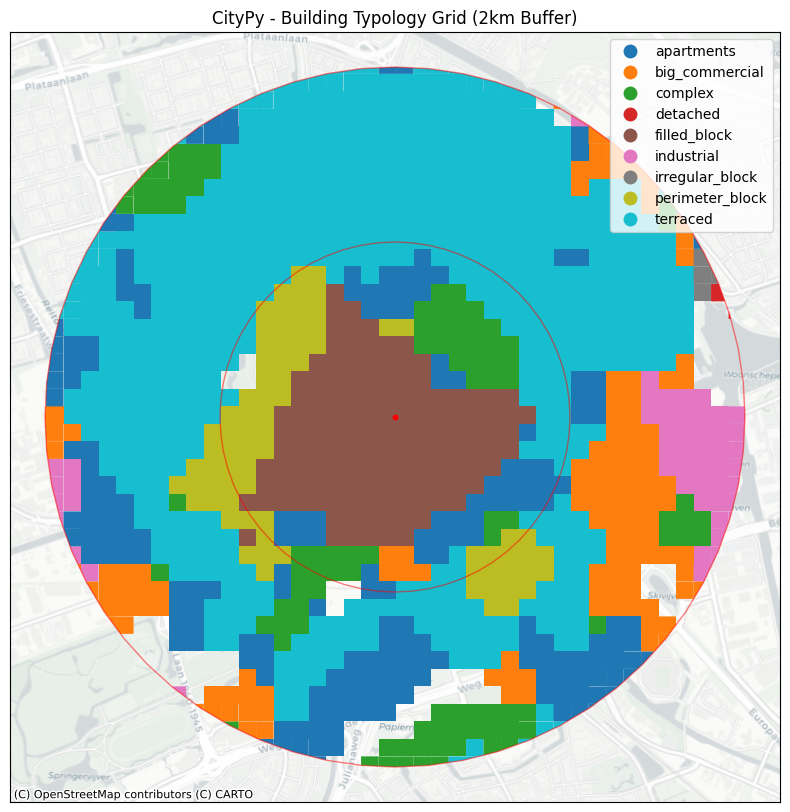

In [ ]:
# same for building typology
# plot buidling grid clipped by 2km
grid_filtered_without_others_2km = grid_filtered_without_others.clip(city_center_buffer_2km)

fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# grid by building_class
grid_filtered_without_others_2km.plot(ax=ax, column = "building_class", cmap = "tab10", legend = True)

# city center, always be the topmost layer  
city_center.plot(ax=ax, color = "red", markersize = 10)

city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)

# base map
ctx.add_basemap(ax, crs=groningen_citypy.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CityPy - Building Typology Grid (2km Buffer)")
plt.show()

/var/folders/h9/289jzm0x6t5gf73w3pky7x2c0000gn/T/ipykernel_87897/3513633466.py:20: DeprecationWarning:

The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.



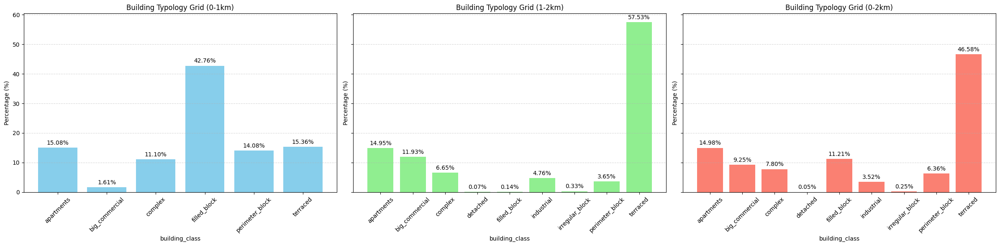

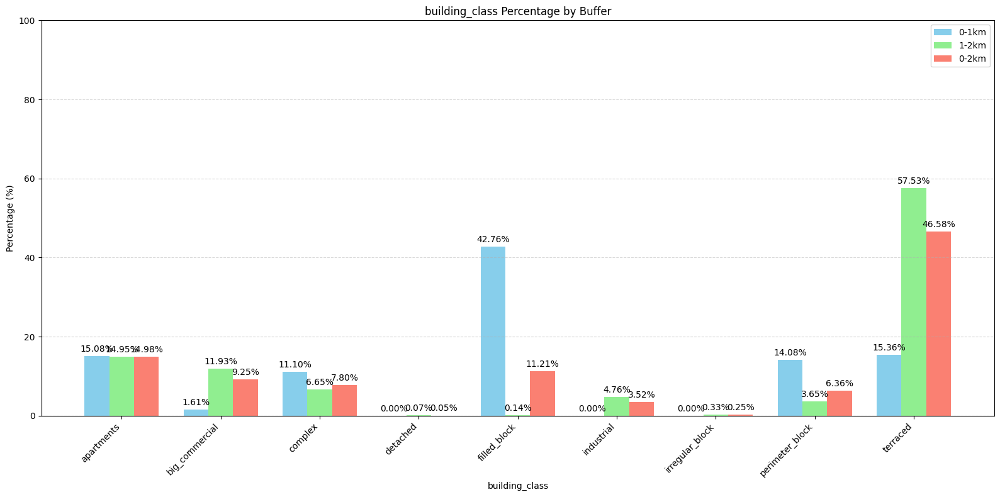

In [ ]:
# same for bldg typo grid
# use functions for buildings
grid_1km_df   = calculate_area_percentages(grid_filtered_without_others, city_center_buffer_1km, "building_class")
grid_2km_df   = calculate_area_percentages(grid_filtered_without_others, city_center_buffer_2km, "building_class")
grid_1_2km_df = calculate_area_percentages_ring(grid_filtered_without_others, city_center_buffer_2km, city_center_buffer_1km, "building_class")

plot_side_by_side(
    [grid_1km_df, grid_1_2km_df, grid_2km_df],
    ["Building Typology Grid (0-1km)", "Building Typology Grid (1-2km)", "Building Typology Grid (0-2km)"],
    "building_class"
)

plot_grouped(
    [grid_1km_df, grid_1_2km_df, grid_2km_df],
    ["0-1km", "1-2km", "0-2km"],
    "building_class"
)

#### 1.2 Examine CBS output 
- Residents, Number of HH, Single-person HH, Single-parent HH, Two-parent HH, HH w/o children, Average number of HH
- HH = households
- spatial + statistical

In [ ]:
# load cbs data
cbs = gpd.read_file('../data/cbs/cleaned/cbs_filtered.gpkg')
cbs.head()
cbs.columns

Index(['cell_id', 'residents', 'men', 'women', 'ppl_0_to_15', 'ppl_15_to_25',
       'ppl_25_to_45', 'ppl_45_to_65', 'ppl_65_and_older', 'households',
       'single_hh', 'hh_without_children', 'single_parent_hh', 'two_parent_hh',
       'avg_hh_size', 'housing', 'multi_family_units',
       'percentage_of_owner_occupied_units', 'percentage_of_rental_units',
       'rental_owned_by_housing_corporations', 'unoccupied_housing',
       'avg_property_value', 'geometry'],
      dtype='object')

In [ ]:
# this gpkg has 1 layer: "cbs_filtered"
# check crs
print(cbs.crs)

EPSG:28992


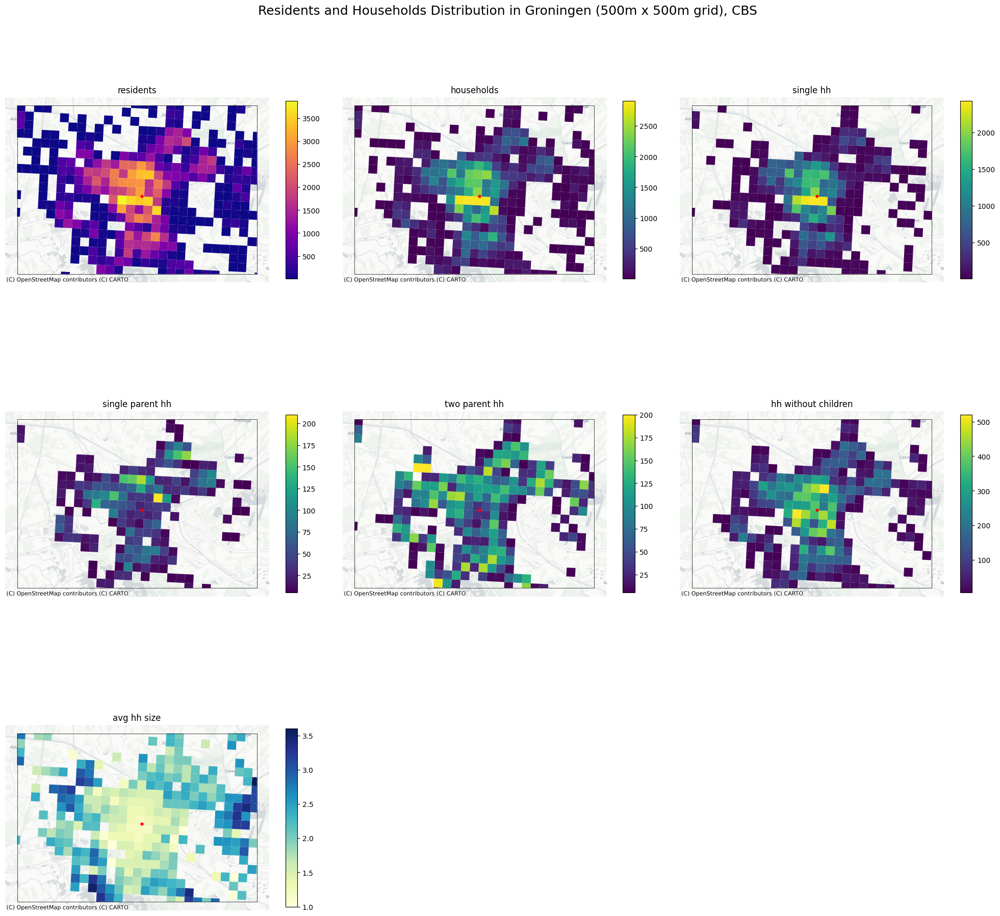

In [ ]:
# select columns to plot
columns = ["residents", "households", "single_hh", "single_parent_hh", "two_parent_hh", "hh_without_children", "avg_hh_size"]

# clip cbs data to groningen bbox
## reproject cbs crs to groningen crs (28992 -> 32632)  
cbs_groningen = cbs.to_crs(groningen_citypy.crs) 
city_center_cbs = city_center.to_crs("EPSG:32632")
#print(cbs_groningen.crs)

# clip cbs data
cbs_clipped = cbs_groningen.clip(groningen_bbox)

# plot multiple columns as subplots
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(20, 20))
axes = axes.flatten()

# colormaps per group
colormap_map = {
    "residents": "plasma",
    "households": "viridis",
    "single_hh": "viridis",
    "single_parent_hh": "viridis",
    "two_parent_hh": "viridis",
    "hh_without_children": "viridis",
    "avg_hh_size": "YlGnBu"
}


for idx, col in enumerate(columns):
    ax = axes[idx]
    cmap = colormap_map[col]
    vmin = cbs_clipped[col].min()
    vmax = cbs_clipped[col].max()

    cbs_clipped.plot(
        column=col, 
        cmap=cmap, 
        legend=True, 
        ax=ax, 
        vmin=vmin,
        vmax=vmax,
        legend_kwds={
            "shrink": 0.5, 
            "aspect": 15}
    )
    groningen_bbox.plot(ax=ax, color="none", edgecolor="black", linewidth=0.5)
    city_center_cbs.plot(ax=ax, color="red", markersize=12)
    ctx.add_basemap(ax, crs=cbs_clipped.crs.to_string(), source=ctx.providers.CartoDB.Positron)
    ax.set_title(col.replace("_", " ").title().lower())
    ax.set_axis_off()

# remove any unused subplot axes
for j in range(len(columns), len(axes)):
    fig.delaxes(axes[j])

plt.suptitle("Residents and Households Distribution in Groningen (500m x 500m grid), CBS", fontsize=18)
plt.tight_layout()
plt.show()

# residents
# households - single hh, single parent hh, two parent hh, hh without children
# avg hh size


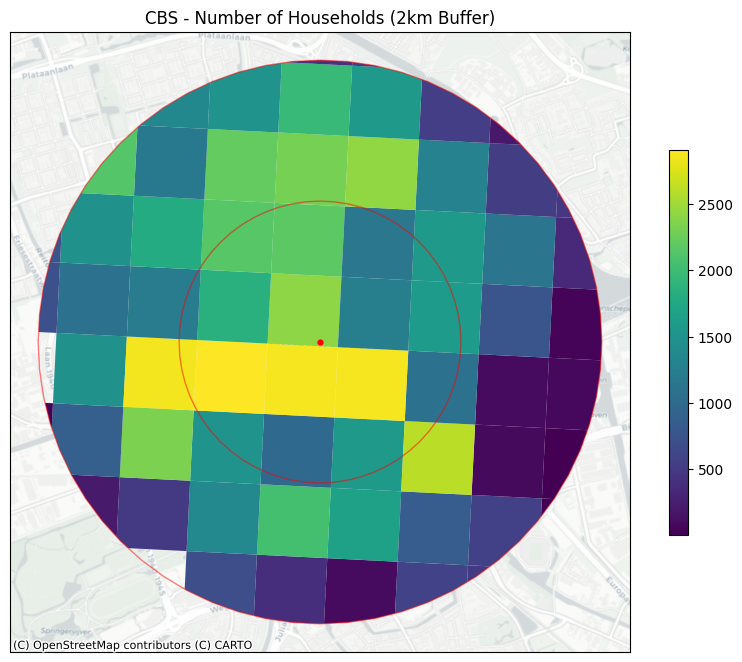

In [ ]:
# clip to 2km buffer
cbs_clipped_2km = cbs_clipped.clip(city_center_buffer_2km)

# plot 2km buffer
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

# cbs clipped 2km
cbs_clipped_2km.plot(ax=ax, column = "households", cmap = "viridis", legend = True, legend_kwds={"shrink": 0.5})

# city center
city_center_cbs.plot(ax=ax, color="red", markersize=12) 

# buffer
city_center_buffer_2km.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=1, alpha=0.5)

# base map
ctx.add_basemap(ax, crs=cbs_clipped_2km.crs, source=ctx.providers.CartoDB.Positron)
plt.title("CBS - Number of Households (2km Buffer)")
plt.show()

In [ ]:
#  do stats analysis with the clipped 2km
cbs_clipped_2km.describe()
#cbs_clipped_2km.head()


,residents,men,women,ppl_0_to_15,ppl_15_to_25,ppl_25_to_45,ppl_45_to_65,ppl_65_and_older,households,single_hh,...,single_parent_hh,two_parent_hh,avg_hh_size,housing,multi_family_units,percentage_of_owner_occupied_units,percentage_of_rental_units,rental_owned_by_housing_corporations,unoccupied_housing,avg_property_value
count,64.000000,64.000000,62.000000,60.000000,62.000000,64.000000,60.000000,59.000000,64.000000,64.000000,...,56.000000,60.000000,64.000000,57.000000,57.000000,57.000000,57.000000,55.000000,57.00000,57.000000
mean,1755.234375,874.687500,908.951613,143.250000,543.064516,622.187500,297.416667,210.254237,1216.484375,859.843750,...,57.321429,78.750000,1.523438,1114.736842,900.701754,28.771930,71.228070,411.363636,61.22807,283.403509
std,1096.956261,544.777423,541.671016,97.179831,498.949187,392.368545,154.194165,140.195134,846.318676,680.191948,...,45.914588,45.422919,0.301184,572.201592,535.622500,17.835576,17.835576,340.351744,54.66032,55.984647
min,10.000000,10.000000,10.000000,10.000000,5.000000,5.000000,20.000000,10.000000,10.000000,10.000000,...,5.000000,5.000000,1.000000,75.000000,5.000000,0.000000,10.000000,15.000000,5.00000,201.000000
25%,898.750000,442.500000,496.250000,68.750000,171.250000,312.500000,156.250000,117.500000,506.250000,278.750000,...,25.000000,35.000000,1.300000,575.000000,465.000000,20.000000,60.000000,197.500000,20.00000,245.000000
50%,1765.000000,885.000000,910.000000,127.500000,390.000000,622.500000,325.000000,185.000000,1170.000000,807.500000,...,40.000000,70.000000,1.500000,1120.000000,885.000000,20.000000,80.000000,355.000000,50.00000,269.000000
75%,2606.250000,1285.000000,1352.500000,193.750000,732.500000,956.250000,408.750000,310.000000,1798.750000,1193.750000,...,70.000000,115.000000,1.600000,1535.000000,1230.000000,40.000000,80.000000,490.000000,80.00000,306.000000
max,3875.000000,1895.000000,2025.000000,390.000000,1915.000000,1350.000000,615.000000,675.000000,2910.000000,2430.000000,...,210.000000,180.000000,2.500000,2140.000000,1960.000000,90.000000,100.000000,1665.000000,260.00000,486.000000


In [ ]:
# Statistical summary for 0–1km, 1–2km, and 0–2km buffers (CBS)
# Requires prior cells to define: cbs_clipped, city_center_buffer_1km, city_center_buffer_2km, and ring_1km_2km or buffer_1km/buffer_2km
def compute_stats(area_gdf: gpd.GeoDataFrame) -> pd.Series:
    if area_gdf is None or area_gdf.empty:
        return pd.Series({
            "cells_count": 0,
            "residents_total": np.nan,
            "households_total": np.nan,
            "avg_hh_size_weighted": np.nan,
            "pct_single_hh": np.nan,
            "pct_single_parent_hh": np.nan,
            "pct_two_parent_hh": np.nan,
            "pct_hh_without_children": np.nan,
        })

    df = area_gdf.copy().replace([np.inf, -np.inf], np.nan)

    residents_sum = df["residents"].sum(min_count=1) if "residents" in df.columns else np.nan
    households_sum = df["households"].sum(min_count=1) if "households" in df.columns else np.nan

    # Weighted average household size by households
    if "avg_hh_size" in df.columns and pd.notna(households_sum) and households_sum > 0:
        weighted_hh_size = (df["avg_hh_size"] * df.get("households", 0)).sum(min_count=1) / households_sum
    else:
        weighted_hh_size = np.nan

    def pct(col: str) -> float:
        if col in df.columns and pd.notna(households_sum) and households_sum > 0:
            return 100.0 * df[col].sum(min_count=1) / households_sum
        return np.nan

    return pd.Series({
        "cells_count": len(df),
        "residents_total": residents_sum,
        "households_total": households_sum,
        "avg_hh_size_weighted": weighted_hh_size,
        "pct_single_hh": pct("single_hh"),
        "pct_single_parent_hh": pct("single_parent_hh"),
        "pct_two_parent_hh": pct("two_parent_hh"),
        "pct_hh_without_children": pct("hh_without_children"),
    })

# Prepare areas
areas = {
    "0_1km": cbs_clipped.clip(city_center_buffer_1km),
    "1_2km": cbs_clipped.clip(ring_1km_2km) if ring_1km_2km is not None else None,
    "0_2km": cbs_clipped_2km,
}

summary = pd.DataFrame({name: compute_stats(gdf) for name, gdf in areas.items()}).T

# Column order and rounding for display
summary = summary[[
    "cells_count",
    "residents_total",
    "households_total",
    "avg_hh_size_weighted",
    "pct_single_hh",
    "pct_single_parent_hh",
    "pct_two_parent_hh",
    "pct_hh_without_children",
]]

summary_display = summary.round({
    "residents_total": 0,
    "households_total": 0,
    "avg_hh_size_weighted": 2,
    "pct_single_hh": 2,
    "pct_single_parent_hh": 2,
    "pct_two_parent_hh": 2,
    "pct_hh_without_children": 2,
})

summary_display


,cells_count,residents_total,households_total,avg_hh_size_weighted,pct_single_hh,pct_single_parent_hh,pct_two_parent_hh,pct_hh_without_children
0_1km,21.0,55960.0,41190.0,1.35,74.69,2.72,4.30,18.31
1_2km,59.0,98210.0,66590.0,1.47,68.87,4.57,6.78,19.79
0_2km,64.0,112335.0,77855.0,1.43,70.68,4.12,6.07,19.13


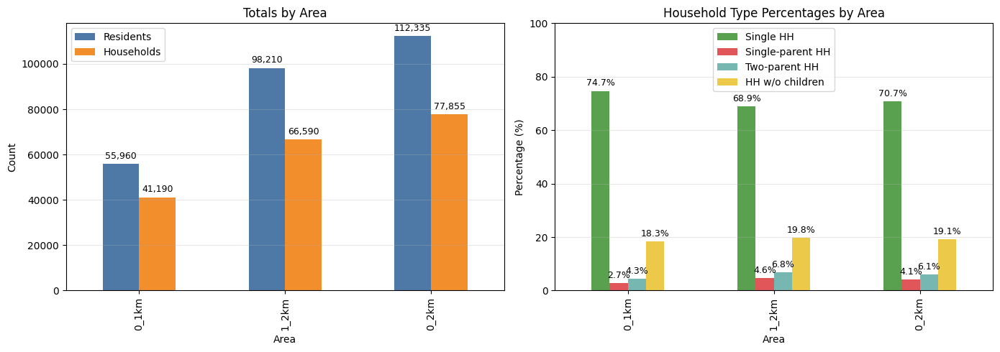

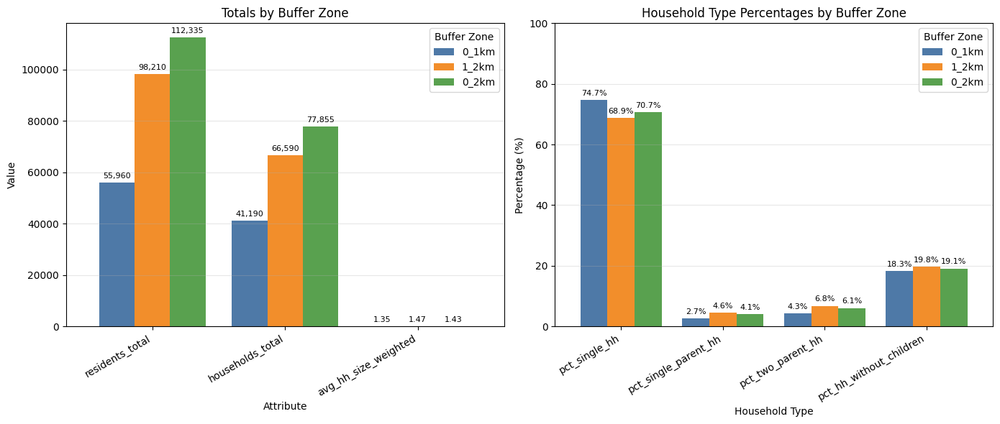

In [ ]:
# Charts comparing 0–1km vs 1–2km vs 0–2km (totals and percentages)
# Ensure `summary_display` exists from the previous cell
try:
    _ = summary_display
except NameError:
    raise RuntimeError("Run the previous summary cell first to create 'summary_display'.")

# --- How to change bar colors ---
# You can set the bar colors by passing the `color` argument to the .plot() function.
# For example: .plot(kind="bar", color=["#1f77b4", "#ff7f0e"], ax=axes[0])
# You can use any list of color names or hex codes. See below for examples.

# Choose your colors here:
totals_colors = ["#4e79a7", "#f28e2b"]  # Example: blue and orange
pct_colors = ["#59a14f", "#e15759", "#76b7b2", "#edc949"]  # Example: green, red, teal, yellow

# Plot totals: residents_total and households_total
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 5))
ax0 = summary_display[["residents_total", "households_total"]].plot(
    kind="bar", 
    color=totals_colors, 
    ax=axes[0]
)
axes[0].set_title("Totals by Area")
axes[0].set_ylabel("Count")
axes[0].set_xlabel("Area")
axes[0].legend(["Residents", "Households"]) 
axes[0].grid(axis="y", alpha=0.3)

# Add values on top of bars for totals
for p in ax0.patches:
    height = p.get_height()
    if not pd.isna(height):
        ax0.annotate(
            f"{int(height):,}", 
            (p.get_x() + p.get_width() / 2, height),
            ha="center", va="bottom", fontsize=9, rotation=0, xytext=(0, 3), textcoords="offset points"
        )

# Plot percentages: household types
pct_cols = [
    "pct_single_hh",
    "pct_single_parent_hh",
    "pct_two_parent_hh",
    "pct_hh_without_children",
]
ax1 = summary_display[pct_cols].plot(
    kind="bar", 
    color=pct_colors, 
    ax=axes[1]
)
axes[1].set_title("Household Type Percentages by Area")
axes[1].set_ylabel("Percentage (%)")
axes[1].set_xlabel("Area")
axes[1].set_ylim(0, 100)
axes[1].legend([
    "Single HH",
    "Single-parent HH",
    "Two-parent HH",
    "HH w/o children",
])
axes[1].grid(axis="y", alpha=0.3)

# Add values on top of bars for percentages
for p in ax1.patches:
    height = p.get_height()
    if not pd.isna(height):
        ax1.annotate(
            f"{height:.1f}%", 
            (p.get_x() + p.get_width() / 2, height),
            ha="center", va="bottom", fontsize=9, rotation=0, xytext=(0, 3), textcoords="offset points"
        )

plt.tight_layout()
plt.show()

# ---
# Combined attribute-centric grouped bar plot (no separate totals and household percentages)
# This plot shows all selected attributes (totals and percentages) together on the x-axis,
# grouped by buffer zone (area). Each group of bars corresponds to an attribute, with one bar per buffer.

# --- Combined Figure: Totals and Household Percentages Side by Side ---

# Define which columns are totals and which are household percentages
totals_cols = [
    "residents_total",
    "households_total",
    "avg_hh_size_weighted",
]
pct_cols = [
    "pct_single_hh",
    "pct_single_parent_hh",
    "pct_two_parent_hh",
    "pct_hh_without_children",
]

# Choose colors for each buffer zone (one color per buffer)
buffer_colors = ["#4e79a7", "#f28e2b", "#59a14f"]  # adjust as needed for your 3 buffers

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# --- Left plot: Totals ---
totals_data = summary_display[totals_cols].T  # rows: attributes, columns: buffers
ax0 = axes[0]
totals_data.plot(
    kind="bar",
    ax=ax0,
    color=buffer_colors,
    width=0.8
)
ax0.set_title("Totals by Buffer Zone")
ax0.set_ylabel("Value")
ax0.set_xlabel("Attribute")
ax0.set_xticklabels(totals_data.index, rotation=30, ha="right")
ax0.legend(totals_data.columns, title="Buffer Zone")
ax0.grid(axis="y", alpha=0.3)

# Add value labels on top of bars for totals
for container, attr_name in zip(ax0.containers, totals_data.index):
    for bar in container:
        height = bar.get_height()
        if not pd.isna(height):
            label = f"{height:.2f}" if not float(height).is_integer() else f"{int(height):,}"
            ax0.annotate(
                label,
                (bar.get_x() + bar.get_width() / 2, height),
                ha="center", va="bottom", fontsize=8, xytext=(0, 3), textcoords="offset points"
            )

# --- Right plot: Household Percentages ---
pct_data = summary_display[pct_cols].T  # rows: attributes, columns: buffers
ax1 = axes[1]
pct_data.plot(
    kind="bar",
    ax=ax1,
    color=buffer_colors,
    width=0.8
)
ax1.set_title("Household Type Percentages by Buffer Zone")
ax1.set_ylabel("Percentage (%)")
ax1.set_xlabel("Household Type")
ax1.set_xticklabels(pct_data.index, rotation=30, ha="right")
ax1.legend(pct_data.columns, title="Buffer Zone")
ax1.set_ylim(0, 100)
ax1.grid(axis="y", alpha=0.3)

# Add value labels on top of bars for percentages
for container, attr_name in zip(ax1.containers, pct_data.index):
    for bar in container:
        height = bar.get_height()
        if not pd.isna(height):
            label = f"{height:.1f}%"
            ax1.annotate(
                label,
                (bar.get_x() + bar.get_width() / 2, height),
                ha="center", va="bottom", fontsize=8, xytext=(0, 3), textcoords="offset points"
            )

plt.tight_layout()
plt.show()


In [ ]:
# .describe() by buffer zones for CBS (0–1km, 1–2km, 0–2km)
# Produces per-zone descriptive stats for numeric columns
# Build zone geometries (unary unions for robust intersects)

geom_0_1 = city_center_buffer_1km.unary_union if isinstance(city_center_buffer_1km, gpd.GeoDataFrame) else city_center_buffer_1km
geom_0_2 = city_center_buffer_2km.unary_union if isinstance(city_center_buffer_2km, gpd.GeoDataFrame) else city_center_buffer_2km
geom_1_2 = ring_1km_2km

# Define zone subsets (restrict universe to 0–2km first)
zones = {}
zones["0_1km"] = cbs_clipped_2km[cbs_clipped_2km.intersects(geom_0_1)]
if geom_1_2 is not None:
    zones["1_2km"] = cbs_clipped_2km[cbs_clipped_2km.intersects(geom_1_2)]
else:
    zones["1_2km"] = gpd.GeoDataFrame(columns=cbs_clipped_2km.columns, crs=cbs_clipped_2km.crs)
zones["0_2km"] = cbs_clipped_2km

# Numeric columns present (from 0–2km subset schema)
numeric_cols = cbs_clipped_2km.select_dtypes(include=[np.number]).columns.tolist()

# Compute describe tables per zone
zone_describe_tables = {}
for zone_name, gdf in zones.items():
    if gdf is None or gdf.empty:
        zone_describe_tables[zone_name] = pd.DataFrame()
        continue
    desc = gdf[numeric_cols].describe().T  # variables as rows
    desc.insert(0, "n", gdf[numeric_cols].count())
    zone_describe_tables[zone_name] = desc

# Concatenate with zone as top-level index for compact viewing
# (Empty zones will be skipped)
concat_list = []
keys = []
for k, df in zone_describe_tables.items():
    if df is not None and not df.empty:
        concat_list.append(df)
        keys.append(k)

if concat_list:
    cbs_describe_by_zone = pd.concat(concat_list, keys=keys, names=["zone", "metric"])  # MultiIndex
    display(cbs_describe_by_zone)
else:
    print("No data available in specified zones for .describe().")

# Also display simple counts per zone for reference
counts_summary = pd.Series({k: (v.shape[0] if v is not None else 0) for k, v in zones.items()}, name="cells_count")
display(counts_summary)


/var/folders/h9/289jzm0x6t5gf73w3pky7x2c0000gn/T/ipykernel_87897/3243913286.py:5: DeprecationWarning:

The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.

/var/folders/h9/289jzm0x6t5gf73w3pky7x2c0000gn/T/ipykernel_87897/3243913286.py:6: DeprecationWarning:

The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.



n  count         mean  \
zone  metric                                                         
0_1km residents                             21   21.0  2664.761905   
      men                                   21   21.0  1330.238095   
      women                                 21   21.0  1334.523810   
      ppl_0_to_15                           21   21.0   138.809524   
      ppl_15_to_25                          21   21.0   973.809524   
...                                         ..    ...          ...   
0_2km percentage_of_owner_occupied_units    57   57.0    28.771930   
      percentage_of_rental_units            57   57.0    71.228070   
      rental_owned_by_housing_corporations  55   55.0   411.363636   
      unoccupied_housing                    57   57.0    61.228070   
      avg_property_value                    57   57.0   283.403509   

                                                   std     min     25%  \
zone  metric                                                             
0_1km residents                             784.333278  1195.0  1950.0   
      men                                   396.816948   605.0  1035.0   
      women                                 399.449323   590.0   995.0   
      ppl_0_to_15                            93.473322    20.0    80.0   
      ppl_15_to_25                          516.524212   290.0   550.0   
...                                                ...     ...     ...   
0_2km percentage_of_owner_occupied_units     17.835576     0.0    20.0   
      percentage_of_rental_units             17.835576    10.0    60.0   
      rental_owned_by_housing_corporations  340.351744    15.0   197.5   
      unoccupied_housing                     54.660320     5.0    20.0   
      avg_property_value                     55.984647   201.0   245.0   

                                               50%     75%     max  
zone  metric                                                        
0_1km residents                             2830.0  3410.0  3875.0  
      men                                   1335.0  1660.0  1895.0  
      women                                 1405.0  1645.0  2025.0  
      ppl_0_to_15                            120.0   190.0   370.0  
      ppl_15_to_25                           915.0  1260.0  1915.0  
...                                            ...     ...     ...  
0_2km percentage_of_owner_occupied_units      20.0    40.0    90.0  
      percentage_of_rental_units              80.0    80.0   100.0  
      rental_owned_by_housing_corporations   355.0   490.0  1665.0  
      unoccupied_housing                      50.0    80.0   260.0  
      avg_property_value                     269.0   306.0   486.0  

[63 rows x 9 columns]

0_1km    21
1_2km    59
0_2km    64
Name: cells_count, dtype: int64

0_1km    21
1_2km    59
0_2km    64
Name: cells_count, dtype: int64

In [ ]:
# print the list of metric in cbs_describe_by_zone
print(cbs_describe_by_zone.index.tolist())

[('0_1km', 'residents'), ('0_1km', 'men'), ('0_1km', 'women'), ('0_1km', 'ppl_0_to_15'), ('0_1km', 'ppl_15_to_25'), ('0_1km', 'ppl_25_to_45'), ('0_1km', 'ppl_45_to_65'), ('0_1km', 'ppl_65_and_older'), ('0_1km', 'households'), ('0_1km', 'single_hh'), ('0_1km', 'hh_without_children'), ('0_1km', 'single_parent_hh'), ('0_1km', 'two_parent_hh'), ('0_1km', 'avg_hh_size'), ('0_1km', 'housing'), ('0_1km', 'multi_family_units'), ('0_1km', 'percentage_of_owner_occupied_units'), ('0_1km', 'percentage_of_rental_units'), ('0_1km', 'rental_owned_by_housing_corporations'), ('0_1km', 'unoccupied_housing'), ('0_1km', 'avg_property_value'), ('1_2km', 'residents'), ('1_2km', 'men'), ('1_2km', 'women'), ('1_2km', 'ppl_0_to_15'), ('1_2km', 'ppl_15_to_25'), ('1_2km', 'ppl_25_to_45'), ('1_2km', 'ppl_45_to_65'), ('1_2km', 'ppl_65_and_older'), ('1_2km', 'households'), ('1_2km', 'single_hh'), ('1_2km', 'hh_without_children'), ('1_2km', 'single_parent_hh'), ('1_2km', 'two_parent_hh'), ('1_2km', 'avg_hh_size'), (

/var/folders/h9/289jzm0x6t5gf73w3pky7x2c0000gn/T/ipykernel_87897/1653344577.py:10: UserWarning:

Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations



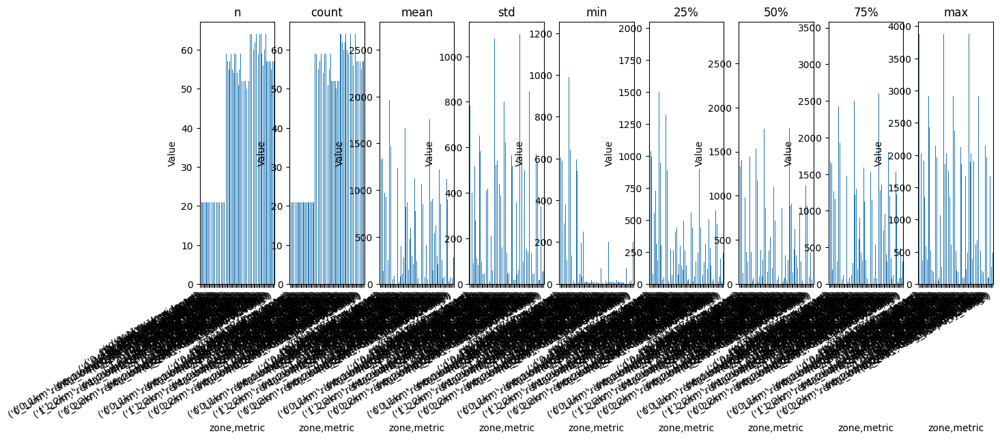

In [ ]:
# plot cbs_describe_by_zone for each metric by index
fig, axes = plt.subplots(nrows=1, ncols=len(cbs_describe_by_zone.columns), figsize=(15, 5))

for i, metric in enumerate(cbs_describe_by_zone.columns):
    cbs_describe_by_zone[metric].plot(kind="bar", ax=axes[i])
    axes[i].set_title(metric)
    axes[i].set_ylabel("Value")
    axes[i].set_xticklabels(cbs_describe_by_zone.index, rotation=30, ha="right")

plt.tight_layout()
plt.show()

# plot cbs_describe_by_zone for each metrics


In [ ]:
# TODO: roughly need to couple which residential building (BAG) is which type of housing - apartment, detached, terraced, etc. (CityPy), and for each type of housing, what kind of household lives where (CBS)

### 1.3 Examine BAG Data
- Purpose:
- Spatial + statistical 

#### 1.3.1 Download and clean data

In [ ]:
# load full bag data
#bag = gpd.read_file('../data/bag/bag-light.gpkg')

In [ ]:
# list layers names
# layers_full = fiona.listlayers('../data/bag/bag-light.gpkg')
# print(layers_full)

In [ ]:
# # split and save each layer to a new gpkg for ease
# full_bag_path = "../data/bag/bag-light.gpkg"
# split_dir = Path("../data/bag/split_layers/")
# split_dir.mkdir(parents=True, exist_ok=True)

# layers = fiona.listlayers(full_bag_path)

# for layer in layers:
#     gdf = gpd.read_file(full_bag_path, layer=layer)
#     if not gdf.empty:
#         out_path = split_dir / f"{layer}.gpkg"
#         gdf.to_file(out_path, driver="GPKG")
#         print(f"Saved: {layer} → {out_path.name}")

In [ ]:
# # call necessary layers - pand, verblijfsobject, woonplaats = bldg footprint, residence, boundary
# footprint = gpd.read_file("../data/bag/original/split_layers/pand.gpkg")
# residence = gpd.read_file("../data/bag/original/split_layers/verblijfsobject.gpkg")
# boundary = gpd.read_file("../data/bag/original/split_layers/woonplaats.gpkg")

In [ ]:
# bag is in epsg:28992, preserve that for now
groningen_bbox_28992 = groningen_bbox.to_crs("EPSG:28992")
extents_groningen_28992 = extents.to_crs("EPSG:28992")

In [ ]:
# # clip to groningen bbox and save! so it doesn't have to be run again
# footprint_groningen = footprint.clip(groningen_bbox_28992)
# residence_groningen = residence.clip(groningen_bbox_28992)
# boundary_groningen = boundary.clip(groningen_bbox_28992)

# # save each layer
# footprint_groningen.to_file("../data/bag/groningen/pand_groningen.gpkg", driver="GPKG")
# residence_groningen.to_file("../data/bag/groningen/verblijfsobject_groningen.gpkg", driver="GPKG")
# boundary_groningen.to_file("../data/bag/groningen/woonplaats_groningen.gpkg", driver="GPKG")

In [ ]:
# call each layer
footprint_groningen = gpd.read_file("../data/bag/groningen/pand_groningen.gpkg")
residence_groningen = gpd.read_file("../data/bag/groningen/verblijfsobject_groningen.gpkg")
boundary_groningen = gpd.read_file("../data/bag/groningen/woonplaats_groningen.gpkg")

### 1.3.2 'Pand' layer
- **Conclusion**
1. 

In [ ]:
# clip to groningen extents
footprint_groningen = footprint_groningen.clip(extents_groningen_28992)

In [ ]:
# examine footprint_groningen layer
print(f"Pand layer shape: {footprint_groningen.shape}")
footprint_groningen.head(10)

Pand layer shape: (91789, 9)


,rdf_seealso,identificatie,bouwjaar,status,gebruiksdoel,oppervlakte_min,oppervlakte_max,aantal_verblijfsobjecten,geometry
96,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010968904,1923,Pand in gebruik,None,NaN,NaN,0,"POLYGON ((232643.935 577773.66, 232640.991 577..."
102,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010929427,1923,Pand in gebruik,woonfunctie,146.0,146.0,1,"POLYGON ((232625.845 577785.409, 232627.11 577..."
103,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010922382,1930,Pand in gebruik,woonfunctie,257.0,257.0,1,"POLYGON ((232645.572 577791.625, 232639.02 577..."
107,http://bag.basisregistraties.overheid.nl/bag/i...,0014100022189701,2016,Pand in gebruik,woonfunctie,179.0,179.0,1,"POLYGON ((232611.23 577834.426, 232619.291 577..."
108,http://bag.basisregistraties.overheid.nl/bag/i...,0014100040032481,2017,Pand in gebruik,None,NaN,NaN,0,"POLYGON ((232601.405 577838.728, 232603.037 57..."
109,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010936470,1910,Pand in gebruik,woonfunctie,174.0,174.0,1,"POLYGON ((232611.774 577852.286, 232613.119 57..."
110,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010968905,1910,Pand in gebruik,None,NaN,NaN,0,"POLYGON ((232593.907 577857.108, 232593.118 57..."
111,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010922381,1931,Pand in gebruik,woonfunctie,168.0,168.0,1,"POLYGON ((232619.698 577865.562, 232617.272 57..."
112,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010936469,1920,Pand in gebruik,woonfunctie,212.0,212.0,1,"POLYGON ((232625.471 577877.084, 232617.609 57..."
1560,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010945647,2002,Pand in gebruik,woonfunctie,211.0,211.0,1,"POLYGON ((232445.427 577814.697, 232447.935 57..."


In [ ]:
print(f"Pand layer columns: {footprint_groningen.columns}")

Pand layer columns: Index(['rdf_seealso', 'identificatie', 'bouwjaar', 'status', 'gebruiksdoel',
       'oppervlakte_min', 'oppervlakte_max', 'aantal_verblijfsobjecten',
       'geometry'],
      dtype='object')


In [ ]:
 # remove 'red_seealso' column
# footprint_groningen = footprint_groningen.drop(columns=["rdf_seealso"])

In [ ]:
# show rows where gebruiksdoel is None
footprint_groningen[footprint_groningen["gebruiksdoel"].isnull()]
print(f"Num of rows where gebruiksdoel is None: {len(footprint_groningen[footprint_groningen['gebruiksdoel'].isnull()])}")

# from where gebruiksdoel is None, what is the unique values of aantal_verblijfobjecten?
footprint_groningen[footprint_groningen["gebruiksdoel"].isnull()]["aantal_verblijfsobjecten"].unique()
print(f"Unique values of aantal_verblijfobjecten where gebruiksdoel is None: {footprint_groningen[footprint_groningen['gebruiksdoel'].isnull()]['aantal_verblijfsobjecten'].unique()}")

# number of nan values in oppervlakte_min and oppervlakte_max
print(f"Num of nan values in oppervlakte_min: {footprint_groningen['oppervlakte_min'].isnull().sum()}")
print(f"Num of nan values in oppervlakte_max: {footprint_groningen['oppervlakte_max'].isnull().sum()}")



Num of rows where gebruiksdoel is None: 33658
Unique values of aantal_verblijfobjecten where gebruiksdoel is None: [0]
Num of nan values in oppervlakte_min: 33658
Num of nan values in oppervlakte_max: 33658


In [ ]:
#delete rows where oppervlakte_min is nan
footprint_groningen = footprint_groningen.dropna(subset=["oppervlakte_min"])
print(f"Number of pand after deleting rows where oppervlakte_min is nan: {footprint_groningen.shape}")
footprint_groningen.head(10)

Number of pand after deleting rows where oppervlakte_min is nan: (58131, 9)


,rdf_seealso,identificatie,bouwjaar,status,gebruiksdoel,oppervlakte_min,oppervlakte_max,aantal_verblijfsobjecten,geometry
102,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010929427,1923,Pand in gebruik,woonfunctie,146.0,146.0,1,"POLYGON ((232625.845 577785.409, 232627.11 577..."
103,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010922382,1930,Pand in gebruik,woonfunctie,257.0,257.0,1,"POLYGON ((232645.572 577791.625, 232639.02 577..."
107,http://bag.basisregistraties.overheid.nl/bag/i...,0014100022189701,2016,Pand in gebruik,woonfunctie,179.0,179.0,1,"POLYGON ((232611.23 577834.426, 232619.291 577..."
109,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010936470,1910,Pand in gebruik,woonfunctie,174.0,174.0,1,"POLYGON ((232611.774 577852.286, 232613.119 57..."
111,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010922381,1931,Pand in gebruik,woonfunctie,168.0,168.0,1,"POLYGON ((232619.698 577865.562, 232617.272 57..."
112,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010936469,1920,Pand in gebruik,woonfunctie,212.0,212.0,1,"POLYGON ((232625.471 577877.084, 232617.609 57..."
1560,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010945647,2002,Pand in gebruik,woonfunctie,211.0,211.0,1,"POLYGON ((232445.427 577814.697, 232447.935 57..."
1977,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010929428,1991,Pand in gebruik,woonfunctie,147.0,147.0,1,"POLYGON ((232514.841 578053.213, 232515.477 57..."
2003,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010957821,1994,Pand in gebruik,woonfunctie,121.0,121.0,1,"POLYGON ((232503.921 578078.425, 232508.359 57..."
2120,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010908333,1992,Pand in gebruik,woonfunctie,122.0,150.0,17,"POLYGON ((232490.71 578112.25, 232488.922 5781..."


In [ ]:
# describe oppervlakte_min, oppervlakte_max, aantal_verblijfobjecten
footprint_groningen.describe()

,bouwjaar,oppervlakte_min,oppervlakte_max,aantal_verblijfsobjecten
count,58131.000000,58131.000000,58131.000000,58131.000000
mean,1963.371334,185.287901,215.538955,2.214412
std,40.694967,1575.381871,1695.351010,7.830917
min,1225.000000,1.000000,1.000000,1.000000
25%,1935.000000,71.000000,89.000000,1.000000
50%,1971.000000,111.000000,117.000000,1.000000
75%,1992.000000,139.000000,146.000000,1.000000
max,2024.000000,278649.000000,278649.000000,489.000000


In [ ]:
# save this cleaned to bag/groningen/final
footprint_groningen.to_file("../data/bag/groningen/final/pand_groningen_final.gpkg", driver="GPKG")

# load this cleaned layer
footprint_gfin = gpd.read_file("../data/bag/groningen/final/pand_groningen_final.gpkg")
# rows that at least once mentions "woonfunctie"

In [ ]:
# rows that at least once mentions "woonfunctie"
footprint_gfin[footprint_gfin["gebruiksdoel"].str.contains("woonfunctie")]


,rdf_seealso,identificatie,bouwjaar,status,gebruiksdoel,oppervlakte_min,oppervlakte_max,aantal_verblijfsobjecten,geometry
0,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010929427,1923,Pand in gebruik,woonfunctie,146.0,146.0,1,"POLYGON ((232625.845 577785.409, 232627.11 577..."
1,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010922382,1930,Pand in gebruik,woonfunctie,257.0,257.0,1,"POLYGON ((232645.572 577791.625, 232639.02 577..."
2,http://bag.basisregistraties.overheid.nl/bag/i...,0014100022189701,2016,Pand in gebruik,woonfunctie,179.0,179.0,1,"POLYGON ((232611.23 577834.426, 232619.291 577..."
3,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010936470,1910,Pand in gebruik,woonfunctie,174.0,174.0,1,"POLYGON ((232611.774 577852.286, 232613.119 57..."
4,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010922381,1931,Pand in gebruik,woonfunctie,168.0,168.0,1,"POLYGON ((232619.698 577865.562, 232617.272 57..."
...,...,...,...,...,...,...,...,...,...
58126,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010926724,1995,Pand in gebruik,woonfunctie,120.0,120.0,1,"POLYGON ((237125.645 584806.247, 237122.178 58..."
58127,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010958195,1914,Pand in gebruik,"industriefunctie,woonfunctie",657.0,657.0,1,"POLYGON ((237039.533 585188.547, 237032.663 58..."
58128,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010948416,1981,Pand in gebruik,woonfunctie,123.0,123.0,1,"POLYGON ((236206.22 585951.31, 236210.13 58595..."
58129,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010913002,1981,Pand in gebruik,woonfunctie,173.0,173.0,1,"POLYGON ((236317.63 585858.46, 236314.8 585859..."


In [ ]:
extents_groningen_28992

,geometry
0,"POLYGON ((226868.863 580018.287, 226878.757 57..."


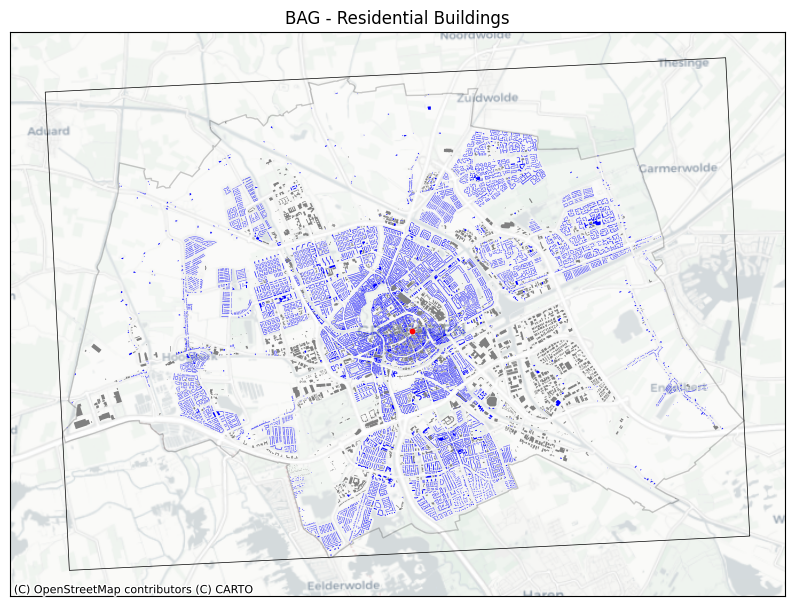

In [ ]:
# plot gebruiksdoel == woonfunctie 
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xticks([])
ax.set_yticks([])

extents_groningen_28992.plot(ax=ax, color= "white", edgecolor="black", alpha = 0.2)

# boolean mask for woonfunctie
is_woonfunctie = footprint_gfin["gebruiksdoel"].str.contains("woonfunctie", na=False)

# woonfunctie in one color
footprint_gfin[is_woonfunctie].plot(ax=ax, color="blue",label="woonfunctie")

# plot other in another color
footprint_gfin[~is_woonfunctie].plot(ax=ax, color="gray", label="other")

# add city boundary and basemap
groningen_bbox_28992.plot(ax=ax, color="none", edgecolor="black", linewidth=0.5)
city_center_groningen_28992 = city_center_cbs.to_crs("EPSG:28992")
city_center_groningen_28992.plot(ax=ax, color="red", markersize=10, legend=True)
ctx.add_basemap(ax, crs=footprint_gfin.crs, source=ctx.providers.CartoDB.Positron)

# add title
plt.title("BAG - Residential Buildings")
plt.show()



### 1.3.3 'Verblijfsobject' layer
- **Conclusion**
1. 

In [ ]:
# clip to groningen extents
residence_groningen_full = residence_groningen.clip(extents_groningen_28992)

# residence layer
print(f"Residence layer shape: {residence_groningen.shape}")
residence_groningen_full.tail(5)


Residence layer shape: (132854, 20)


,rdf_seealso,identificatie,oppervlakte,status,gebruiksdoel,openbare_ruimte_naam,openbare_ruimte_naam_kort,huisnummer,huisletter,toevoeging,postcode,woonplaats_naam,bouwjaar,pand_identificatie,pandstatus,nummeraanduiding_hoofdadres_identificatie,openbare_ruimte_identificatie,woonplaats_identificatie,bronhouder_identificatie,geometry
131110,http://bag.basisregistraties.overheid.nl/bag/i...,0014010011021569,139,Verblijfsobject in gebruik,woonfunctie,Scheltemaheerd,None,61,None,None,9736AJ,Groningen,1982.0,0014100010934189,Pand in gebruik,0014200010826604,0014300010785876,1070,0014,POINT (235704.53 585998.259)
131114,http://bag.basisregistraties.overheid.nl/bag/i...,0014010011032082,139,Verblijfsobject in gebruik,woonfunctie,Scheltemaheerd,None,65,None,None,9736AK,Groningen,1982.0,0014100010913027,Pand in gebruik,0014200010837767,0014300010785876,1070,0014,POINT (235683.954 586000.791)
131146,http://bag.basisregistraties.overheid.nl/bag/i...,0014010011005176,139,Verblijfsobject in gebruik,woonfunctie,Scheltemaheerd,None,66,None,None,9736AK,Groningen,1982.0,0014100010906073,Pand in gebruik,0014200010811390,0014300010785876,1070,0014,POINT (235683.685 586006.342)
131149,http://bag.basisregistraties.overheid.nl/bag/i...,0014010011060687,144,Verblijfsobject in gebruik,woonfunctie,Scheltemaheerd,None,67,None,None,9736AK,Groningen,1982.0,0014100010913026,Pand in gebruik,0014200010868211,0014300010785876,1070,0014,POINT (235684.475 586011.667)
131152,http://bag.basisregistraties.overheid.nl/bag/i...,0014010011010186,144,Verblijfsobject in gebruik,woonfunctie,Scheltemaheerd,None,68,None,None,9736AK,Groningen,1982.0,0014100010934190,Pand in gebruik,0014200010817353,0014300010785876,1070,0014,POINT (235685.27 586017.032)


In [ ]:
# find null count for each column
residence_groningen_full.isnull().sum()

rdf_seealso                                       0
identificatie                                     0
oppervlakte                                       0
status                                            0
gebruiksdoel                                      0
openbare_ruimte_naam                              0
openbare_ruimte_naam_kort                    126482
huisnummer                                        0
huisletter                                   105433
toevoeging                                   104321
postcode                                       5964
woonplaats_naam                                   0
bouwjaar                                          0
pand_identificatie                                0
pandstatus                                        0
nummeraanduiding_hoofdadres_identificatie         0
openbare_ruimte_identificatie                     0
woonplaats_identificatie                          0
bronhouder_identificatie                          0
geometry    

In [ ]:
# delete columns: rdf_seealso, openbare_ruimte_naam_kort, nummeraanduiding_hoofdadres_identificatie, openbare_ruimte_identificatie, bronhouder_identificatie, woonplaats_naam, woonplaats_idnetificatie
residence_gfin = residence_groningen_full.drop(columns=["rdf_seealso", "openbare_ruimte_naam_kort", "nummeraanduiding_hoofdadres_identificatie", "openbare_ruimte_identificatie", "bronhouder_identificatie", "woonplaats_naam", "woonplaats_identificatie"])


In [ ]:
# save residence_groningen_cleaned 
residence_gfin.to_file("../data/bag/groningen/final/verblijfsobject_groningen_final.gpkg", driver="GPKG")


In [ ]:
residence_gfin.isnull().sum()

identificatie                0
oppervlakte                  0
status                       0
gebruiksdoel                 0
openbare_ruimte_naam         0
huisnummer                   0
huisletter              105433
toevoeging              104321
postcode                  5964
bouwjaar                     0
pand_identificatie           0
pandstatus                   0
geometry                     0
dtype: int64

In [ ]:
residence_gfin["gebruiksdoel"].value_counts()

gebruiksdoel
woonfunctie                                               114040
overige gebruiksfunctie                                     6336
industriefunctie                                            2349
winkelfunctie                                               1750
kantoorfunctie                                              1711
                                                           ...  
onderwijsfunctie,overige gebruiksfunctie                       1
gezondheidszorgfunctie,winkelfunctie                           1
bijeenkomstfunctie,kantoorfunctie,winkelfunctie                1
bijeenkomstfunctie,gezondheidszorgfunctie,sportfunctie         1
bijeenkomstfunctie,kantoorfunctie,woonfunctie                  1
Name: count, Length: 66, dtype: int64

In [ ]:
# find rows where postcode is null
residence_gfin[residence_gfin["postcode"].isnull()].head(100)

,identificatie,oppervlakte,status,gebruiksdoel,openbare_ruimte_naam,huisnummer,huisletter,toevoeging,postcode,bouwjaar,pand_identificatie,pandstatus,geometry
3117,0014010011091850,18,Verblijfsobject in gebruik,overige gebruiksfunctie,M.K. Gandhiplein,90,None,aa,None,1989.0,0014100010952588,Pand in gebruik,POINT (233274.29 578335.981)
3119,0014010011091851,19,Verblijfsobject in gebruik,overige gebruiksfunctie,M.K. Gandhiplein,90,None,ab,None,1989.0,0014100010952588,Pand in gebruik,POINT (233271.694 578336.714)
3121,0014010011091852,19,Verblijfsobject in gebruik,overige gebruiksfunctie,M.K. Gandhiplein,90,None,ac,None,1989.0,0014100010952588,Pand in gebruik,POINT (233268.254 578337.647)
3248,0014010011092077,19,Verblijfsobject in gebruik,overige gebruiksfunctie,M.K. Gandhiplein,90,None,ar,None,1989.0,0014100010924190,Pand in gebruik,POINT (233200.611 578357.856)
3250,0014010011092078,19,Verblijfsobject in gebruik,overige gebruiksfunctie,M.K. Gandhiplein,90,None,as,None,1989.0,0014100010924190,Pand in gebruik,POINT (233198.165 578358.219)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9657,0014010011088083,19,Verblijfsobject in gebruik,overige gebruiksfunctie,Galenuslaan,24,None,dr,None,1962.0,0014100010925983,Pand in gebruik,POINT (233233.469 579286.429)
9659,0014010011088084,19,Verblijfsobject in gebruik,overige gebruiksfunctie,Galenuslaan,24,None,ds,None,1962.0,0014100010954273,Pand in gebruik,POINT (233230.674 579287.263)
9663,0014010011088085,19,Verblijfsobject in gebruik,overige gebruiksfunctie,Galenuslaan,24,None,dt,None,1962.0,0014100010925984,Pand in gebruik,POINT (233227.879 579288.096)
9676,0014010011088086,19,Verblijfsobject in gebruik,overige gebruiksfunctie,Galenuslaan,24,None,du,None,1962.0,0014100010933045,Pand in gebruik,POINT (233225.083 579288.93)


In [ ]:
# plot where postcode is null
# residence_gfin[residence_gfin["postcode"].isnull()].plot(figsize=(10, 10))
# plt.show()

### 1.3.4. Make a final dataset from BAG
- **Conclusion**
    - BAG dataset provides information on the number of **housing units** per **building**, and **(avg) surface area**
    - useful layers: 'pand' and 'verblijfsobject'

In [ ]:
### join two tables by 'pand_identificatie'
# first change the 'identificatie' column in pand layer to pand_identificatie
footprint_gfin_clean = footprint_gfin.rename(columns={"identificatie": "pand_identificatie"})

# identify columns with the same names in footprint_gfin and residence_gfin
# print(footprint_gfin_clean.columns)
# print(residence_gfin.columns)

## get mean_oppervlakte 
avg_oppervlakte = (
    residence_gfin.groupby("pand_identificatie")
    .agg(
        mean_oppervlakte=("oppervlakte", "mean"),
        unit_count=("oppervlakte", "count")
    )
    .reset_index())

footprint_gfin_clean_fin = footprint_gfin_clean.merge(avg_oppervlakte, on="pand_identificatie", how="left")
footprint_gfin_clean_fin.head(10)

# find rows where aantal_verblijfobjecten is not equal to unit_count
footprint_gfin_clean_fin[footprint_gfin_clean_fin["aantal_verblijfsobjecten"] != footprint_gfin_clean_fin["unit_count"]]

# # show rows where unit_count is Nan
# footprint_gfin_clean_merge[footprint_gfin_clean_merge["unit_count"].isnull()]

# delete rows where gebruiksdoel is woonfunctie and at the same time unit_count is NaN
# unit_count comes from verblijfsobject layer and if this is NaN, it is okay to disregard woonfunctie
footprint_gfin_clean_fin = footprint_gfin_clean_fin[~((footprint_gfin_clean_fin["aantal_verblijfsobjecten"] == 1) & (footprint_gfin_clean_fin["unit_count"].isnull()))]


In [ ]:
# find rows where aantal_verblijfobjecten is not equal to unit_count
footprint_gfin_clean_fin[footprint_gfin_clean_fin["aantal_verblijfsobjecten"] != footprint_gfin_clean_fin["unit_count"]]


,rdf_seealso,pand_identificatie,bouwjaar,status,gebruiksdoel,oppervlakte_min,oppervlakte_max,aantal_verblijfsobjecten,geometry,mean_oppervlakte,unit_count
368,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010915467,1992,Pand in gebruik,woonfunctie,58.0,147.0,3,"POLYGON ((232937.158 578269.3, 232932.19 57827...",60.000000,2.0
798,http://bag.basisregistraties.overheid.nl/bag/i...,0014100022188392,2008,Pand in gebruik,"gezondheidszorgfunctie,woonfunctie",87.0,16753.0,15,"POLYGON ((233443.362 579024.013, 233447.846 57...",91.500000,14.0
799,http://bag.basisregistraties.overheid.nl/bag/i...,0014100022188391,2008,Pand in gebruik,"gezondheidszorgfunctie,woonfunctie",87.0,16753.0,21,"POLYGON ((233467.964 579056.118, 233472.423 57...",92.100000,20.0
1422,http://bag.basisregistraties.overheid.nl/bag/i...,0014100022190971,2017,Pand in gebruik,"bijeenkomstfunctie,gezondheidszorgfunctie",1691.0,99935.0,2,"POLYGON ((232919.671 579005.189, 232919.659 57...",1691.000000,1.0
2417,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010957063,1938,Pand in gebruik,woonfunctie,36.0,117.0,3,"POLYGON ((233287.457 580692.693, 233284.9 5806...",68.000000,1.0
...,...,...,...,...,...,...,...,...,...,...,...
46526,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010932098,1932,Pand in gebruik,woonfunctie,78.0,90.0,2,"POLYGON ((234938.414 582877.22, 234938.046 582...",90.000000,1.0
47393,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010952118,1954,Pand in gebruik,"industriefunctie,woonfunctie",445.0,748.0,2,"POLYGON ((234860.264 583428.037, 234860.359 58...",445.000000,1.0
47712,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010923612,1933,Pand in gebruik,"bijeenkomstfunctie,woonfunctie",35.0,102.0,5,"POLYGON ((234299.697 583578.801, 234306.115 58...",58.000000,4.0
48934,http://bag.basisregistraties.overheid.nl/bag/i...,0014100010950629,1938,Pand in gebruik,woonfunctie,102.0,192.0,2,"POLYGON ((238566.29 583489.27, 238567.04 58348...",102.000000,1.0


In [ ]:
# keep only rows where 'gebruiksdoel' contains 'woonfunctie'
footprint_gfin_clean_fin = footprint_gfin_clean_fin[
    footprint_gfin_clean_fin["gebruiksdoel"].str.contains("woonfunctie", na=False)
]

# drop rows where unit_count is NaN
footprint_gfin_clean_fin = footprint_gfin_clean_fin.dropna(subset=["unit_count"])

# drop rows where unit_count is not equal to aantal_verblijfsobjecten
footprint_gfin_clean_fin = footprint_gfin_clean_fin[
    footprint_gfin_clean_fin["unit_count"] == footprint_gfin_clean_fin["aantal_verblijfsobjecten"]
]

# drop rdf_seealso column
footprint_gfin_clean_final = footprint_gfin_clean_fin.drop(columns=["rdf_seealso"])

# save this cleaned layer 
footprint_gfin_clean_final.to_file("../data/bag/groningen/final/bag_groningen_final.gpkg", driver="GPKG")

In [ ]:
bag_gfin = gpd.read_file("../data/bag/groningen/final/bag_groningen_final.gpkg")
bag_gfin.head(10)

# show rows where gebruiksdoel is woonfunctie
bag_gfin[bag_gfin["gebruiksdoel"] == "woonfunctie"]

# drop rows where gebruiksdoel is not woonfunctie
bag_gfin = bag_gfin[bag_gfin["gebruiksdoel"] == "woonfunctie"]
bag_gfin.shape

# save this again to bag_groningen_final.gpkg
bag_gfin.to_file("../data/bag/groningen/final/bag_groningen_final.gpkg", driver="GPKG")

In [ ]:
# describe
bag_gfin.describe()


,bouwjaar,oppervlakte_min,oppervlakte_max,aantal_verblijfsobjecten,mean_oppervlakte,unit_count
count,47186.000000,47186.000000,47186.000000,47186.000000,47186.000000,47186.000000
mean,1964.123554,119.443712,126.484317,1.952168,122.570825,1.952168
std,38.191693,129.915590,129.167071,5.521661,128.900173,5.521661
min,1479.000000,10.000000,13.000000,1.000000,13.000000,1.000000
25%,1934.000000,86.000000,96.000000,1.000000,90.000000,1.000000
50%,1973.000000,114.000000,118.000000,1.000000,116.000000,1.000000
75%,1993.000000,139.000000,141.000000,1.000000,140.000000,1.000000
max,2024.000000,21893.000000,21893.000000,467.000000,21893.000000,467.000000


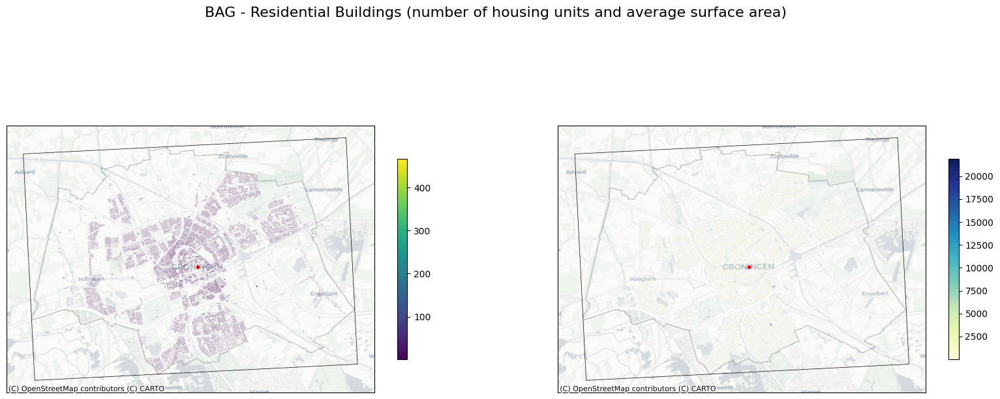

In [ ]:
# plot 2 columns: aantal_verblijfobjecten and avg_oppervlakte 
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 8))        

# plot aantal_verblijfobjecten
axes[0].set_xticks([])
axes[0].set_yticks([])

# shrink legend
bag_gfin.plot(ax=axes[0], column = "aantal_verblijfsobjecten", cmap = "viridis", legend = True, legend_kwds={"shrink": 0.5})
extents_groningen_28992.plot(ax=axes[0], color= "white", edgecolor="black", alpha = 0.2)
groningen_bbox_28992.plot(ax=axes[0], color="none", edgecolor="black", linewidth=0.5)
city_center_groningen_28992.plot(ax=axes[0], color="red", markersize=10, legend=True)


# plot avg_oppervlakte
axes[1].set_xticks([])
axes[1].set_yticks([])

# 
bag_gfin.plot(ax=axes[1], column = "mean_oppervlakte", cmap = "YlGnBu", legend = True, legend_kwds={"shrink": 0.5})
extents_groningen_28992.plot(ax=axes[1], color= "white", edgecolor="black", alpha = 0.2)
groningen_bbox_28992.plot(ax=axes[1], color="none", edgecolor="black", linewidth=0.5)
city_center_groningen_28992.plot(ax=axes[1], color="red", markersize=10, legend=True)

ctx.add_basemap(axes[0], crs=bag_gfin.crs.to_string(), source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(axes[1], crs=bag_gfin.crs.to_string(), source=ctx.providers.CartoDB.Positron)
plt.suptitle("BAG - Residential Buildings (number of housing units and average surface area)", fontsize=16)
plt.show()


### 1.4 Disaggregating data
- Conclusion from examining three datasets: CityPy, CBS, and BAG provide information on (city center, 100m-resolution building typology grid (which is not a 'housing' typology grid')), 500m-resolution resident and household data, and the number of housing units per building, and surfae area, respectively. 
- Purpose: To treat data of different resolution (unit-level, 100m, 500m) and form a conclusion on patterns and distributions 

In [ ]:
# data analysis - grid disaggregation/aggregation

### 2️⃣ Rules
- `rules/rules.md`
------

### 3️⃣ Generate
- `rules/generation.md`

#### 3.1 CityStackGen
- create synthetic baseline (‼️ or should this be tweaked within CityStackGen?) on CityStackGen with base layers (streets, enclosures, buildings)

#### 3.2 Tweaking 
- tweak the base layers based on the rule parameters

#### 3.3 Assign
- assign number of houses, households, etc ....

In [ ]:
# load CityStackGen data outputs - buildings, city center, enclosures, streets
# ‼️ might have to be run again by tweaking the base layers with the rule parameters ‼️
building = gpd.read_file('../citystack/citystackgen/outputs/Groningen_1/buildings.geojson')
city_center = gpd.read_file('../citystack/citystackgen/outputs/Groningen_1/city_center.geojson')
enclosures = gpd.read_file('../citystack/citystackgen/outputs/Groningen_1/enclosures.geojson')
streets = gpd.read_file('../citystack/citystackgen/outputs/Groningen_1/streets.geojson')

In [ ]:
# check CRS from data
print(building.crs)
print(city_center.crs)
print(enclosures.crs)
print(streets.crs)

EPSG:4326
EPSG:4326
EPSG:4326
EPSG:4326
